# Artificial Intelligence Nanodegree

## Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the iPython Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this IPython notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Use a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 6](#step6): Write your Algorithm
* [Step 7](#step7): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

### Import Dog Dataset

In the code cell below, we import a dataset of dog images.  We populate a few variables through the use of the `load_files` function from the scikit-learn library:
- `train_files`, `valid_files`, `test_files` - numpy arrays containing file paths to images
- `train_targets`, `valid_targets`, `test_targets` - numpy arrays containing onehot-encoded classification labels 
- `dog_names` - list of string-valued dog breed names for translating labels

In [1]:
from sklearn.datasets import load_files       
from keras.utils import np_utils
import numpy as np
from glob import glob

# define function to load train, test, and validation datasets
def load_dataset(path):
    data = load_files(path)
    dog_files = np.array(data['filenames'])
    dog_targets = np_utils.to_categorical(np.array(data['target']), 133)
    return dog_files, dog_targets

# load train, test, and validation datasets
train_files, train_targets = load_dataset('dogImages/train')
valid_files, valid_targets = load_dataset('dogImages/valid')
test_files, test_targets = load_dataset('dogImages/test')

# load list of dog names
dog_names = [item[20:-1] for item in sorted(glob("dogImages/train/*/"))]

# print statistics about the dataset
print('There are %d total dog categories.' % len(dog_names))
print('There are %s total dog images.\n' % len(np.hstack([train_files, valid_files, test_files])))
print('There are %d training dog images.' % len(train_files))
print('There are %d validation dog images.' % len(valid_files))
print('There are %d test dog images.'% len(test_files))

There are 133 total dog categories.
There are 8351 total dog images.

There are 6680 training dog images.
There are 835 validation dog images.
There are 836 test dog images.


In [2]:
# Since I can't reference pictures directly from the udacity urls,
# we are gonna use a helper function to embed images properly using html.

from IPython.display import Image, HTML, display
import base64

def to_dog_labels(arr):
    return dog_names[arr.argmax()].split("/")[-1]


def img_to_html(img_path, figcaption="", height="150px"):
    '''convert image to data in base64
    then construct html img block
    '''

    figure_html = '''
    <figure style= '{figstyle}'>
      <img style='{imgstyle}' src='{imgsrc}'/>
      <figcaption style='font-size:80%; text-align:center'>{figcaption}</figcaption>
    </figure>
    '''

    figstyle = "margin: 10px; float: left; border: 3px solid black;"
    imgstyle = "height:{}; padding: 5px;".format(height)


    img_base64 = str(base64.b64encode(Image(img_path).data))[2:]
    
    html = figure_html.format(
        figstyle = figstyle,
        imgstyle = imgstyle,
        imgsrc = 'data:image/jpeg;base64,' + img_base64,
        figcaption = figcaption
    )
    
    return html


def gallery(files, labels="", height="150px"): 
    '''uses html display to show image files inline in jupyter'''
    images_list = ""
    if not labels : 
        for file in files:
            images_list += (img_to_html(file, figcaption="", height=height))
    else : 
        for file, label in zip(files, labels):
            images_list += (img_to_html(file, figcaption=label, height=height))

    display(HTML(images_list))


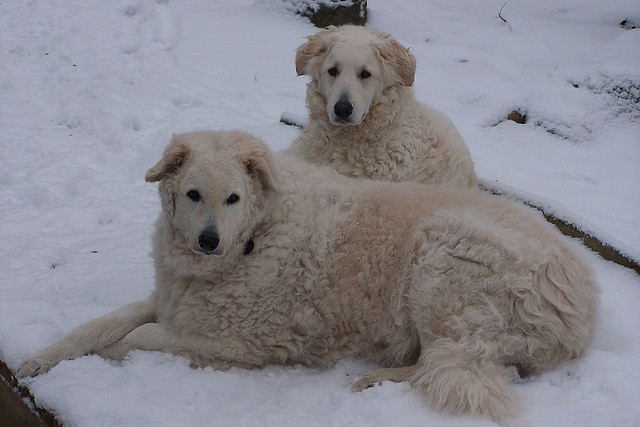
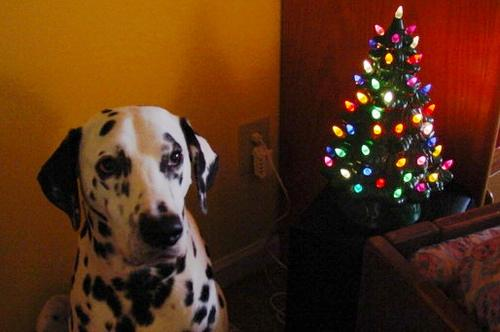
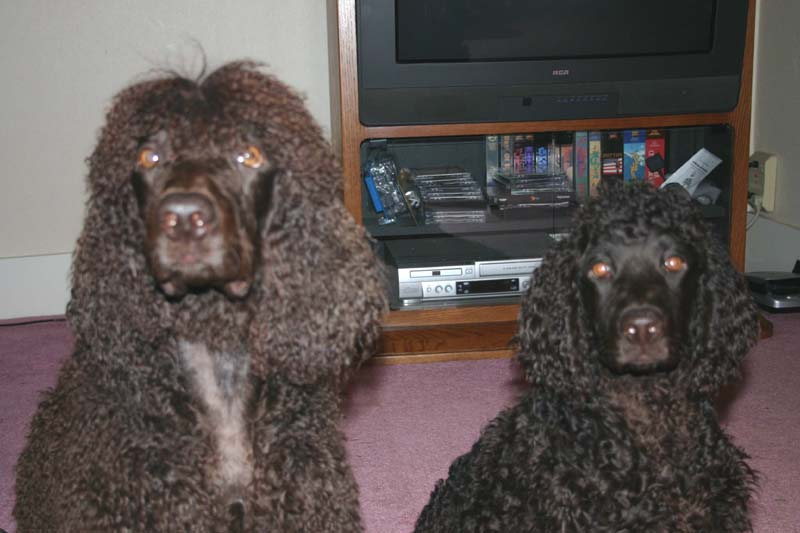
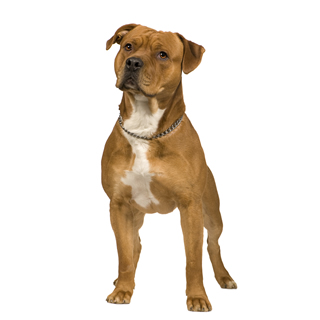
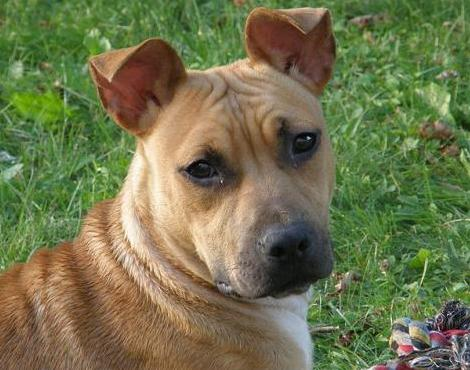
...
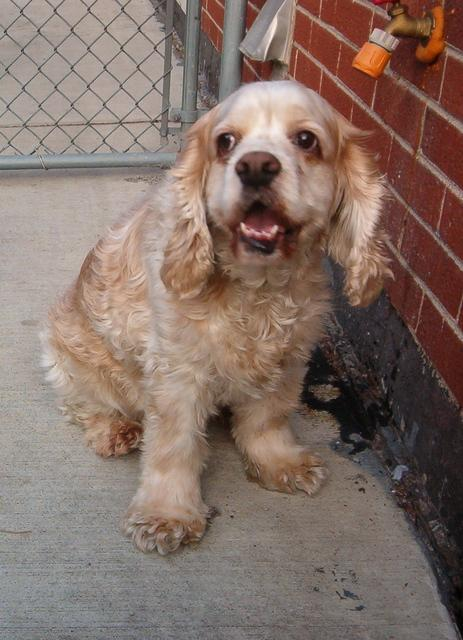
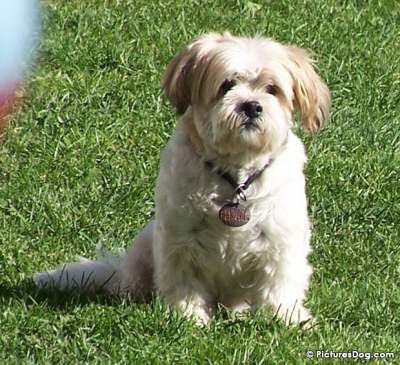
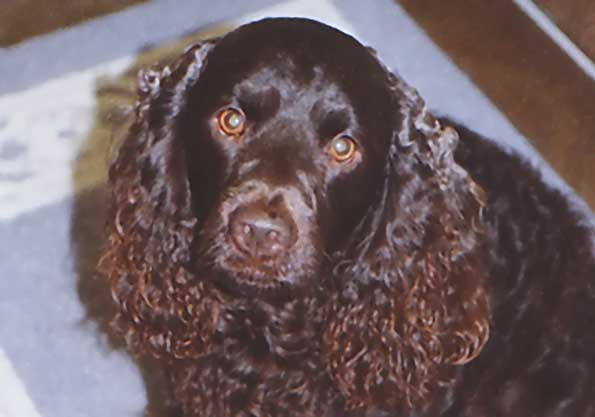
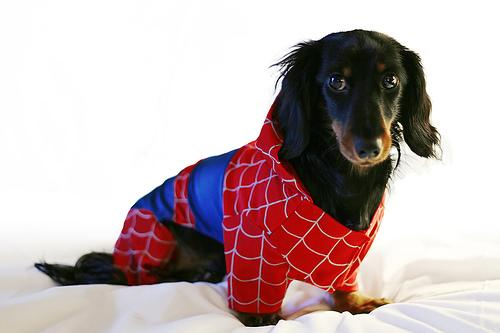
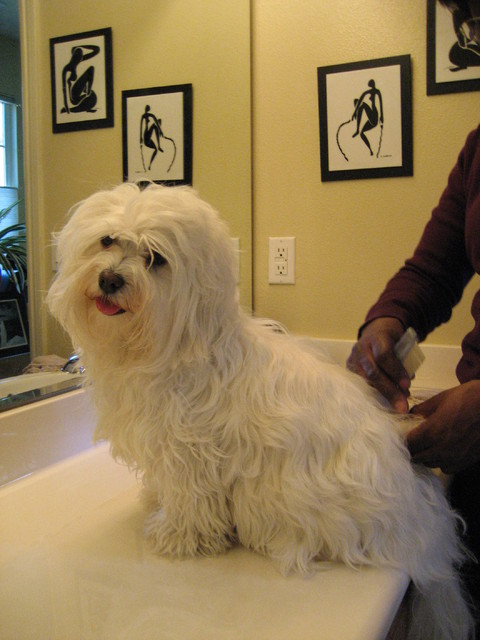

In [3]:
gallery(train_files[:18], [to_dog_labels(t) for t in train_targets[:18]])

### Import Human Dataset

In the code cell below, we import a dataset of human images, where the file paths are stored in the numpy array `human_files`.

In [4]:
import random
random.seed(8675319)

# load filenames in shuffled human dataset
human_files = np.array(glob("lfw/*/*"))
random.shuffle(human_files)

# print statistics about the dataset
print('There are %d total human images.' % len(human_files))

There are 13233 total human images.


---
<a id='step1'></a>
## Step 1: Detect Humans

We use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.

In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


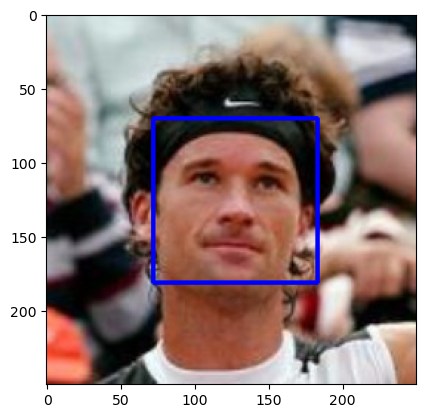

In [5]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[3])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [6]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 

In [7]:
human_files_short = human_files[:100]
dog_files_short = train_files[:100]
# Do NOT modify the code above this line.

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.

# small helper function
def faces_positive(img_list):
    '''implements face_detector over an image list.
    Returns the sum of positive outcomes in a list.
    '''
    results = []
    
    for img in img_list:
        results.append(face_detector(img))
    
    return np.sum(results)
    

print("What percentage of the first 100 images in human_files have a detected human face?")
print((faces_positive(human_files_short)/len(human_files_short))*100)

print("What percentage of the first 100 images in dog_files have a detected human face?")
print((faces_positive(dog_files_short)/len(dog_files_short))*100)

What percentage of the first 100 images in human_files have a detected human face?
97.0
What percentage of the first 100 images in dog_files have a detected human face?
12.0


__Question 2:__ This algorithmic choice necessitates that we communicate to the user that we accept human images only when they provide a clear view of a face (otherwise, we risk having unneccessarily frustrated users!). In your opinion, is this a reasonable expectation to pose on the user? If not, can you think of a way to detect humans in images that does not necessitate an image with a clearly presented face?

__Answer:__
<div class="alert alert-block alert-info">
Answer : I believe "following the rules" is not a very reasonable expectation to pose on the user on the open internet. We might try to mitigate the error as much as we can by trying/layering different algorithms if the technology and ressourcer are available. 

 or (more simply) by designing user inputs into the interface.

- We could explore newer models with larger datasets.
- We could explore and include profile face detection as an additional layer.
- We could compute a "human probability" by combining predictions of 2 or 3 models.
- We could weight a "human probability" by combining human + dog models.

Only if all our alternatives are exhausted we might pass the limitation to the user. We could mitigate the bad experience by providing guidelines or, even better, by designing it into the UX :

- Providing basic guidelines/instructions (i.e. clear images, mainly front facing, etc.)
- We could ask the user for an input: is there a human in the picture?
- On very ambiguous results, refuse to deliver an answer, in order to prevent an even bad experience that is a bad prediction.
</div>

We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on each of the datasets.

In [8]:
## (Optional) TODO: Report the performance of another  
## face detection algorithm on the LFW dataset
### Feel free to use as many code cells as needed.

<div class="alert alert-block alert-info">
<b>Answer : </b>
In the following cells, we compare the Haar-like cascade model vs two common models: 

- Histogram of Oriented Gradients (HOG) (implemented in Dlib)
- Convolutional Neural Network (implemented in Dlib)

<b>Histogram of Oriented Gradients (HOG)</b> appears to have very efficient computation time. Furthermore, it seems to be more accurate that haar-like when finding human faces (99% vs 97%). Again, the results where very close, but slightly better in the dog dataset.

<b>Convolutional Neural Network MMOD</b> had a 100% detection rate for human pictures. However, the computational times are very high and might not suitable for some applications. This was the best performance for dogs in human faces, giving the zero false positives in our test (zero errors). We experimented a bit with image resizing in order to improve computational times. By resizing large images we where able to get to around 8 seconds per image without loosing much accuracy.. 

results : 
    
        
        Part 1: humans in humans
        Begin test of sample of  100
        100%|██████████| 100/100 [05:38<00:00,  3.39s/it]  
          detector # 1 : 97.00 % (haar-like) 
          detector # 2 : 99.00 % (hog-svm)
          detector # 3 : 100.00 % (cnn-mmod)

        Part 2: humans in dogs
        Begin test of sample of  100
        100%|██████████| 100/100 [34:26<00:00, 20.66s/it]    

          detector # 1 : 12.00 % (haar-like) 
          detector # 2 : 8.00 % (hog-svm)
          detector # 3 : 2.00 % (cnn-mmod)


</div>

In [9]:
import dlib
from imutils import face_utils

# Original human face detection Haar-like 
def face_detector(img_path):
    """Returns True if a face is found."""
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0 


# Alternative algorithm # 1 
# Histogram of Oriented Gradients (HOG) in Dlib 
# https://lear.inrialpes.fr/people/triggs/pubs/Dalal-cvpr05.pdf

def hog_face_detector(img_path):
    """Returns True if a face is found."""
    face_hog = dlib.get_frontal_face_detector()
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rects = face_hog(gray, 1)
    return len(rects) > 0


# Alternative algorithm # 2
# Convolutional Neural Network in Dlib
# model file obtained here: http://dlib.net/files/mmod_human_face_detector.dat.bz2

def cnn_face_detector(img_path):
    """Returns True if a face is found."""
    face_cnn = dlib.cnn_face_detection_model_v1("mmod/mmod_human_face_detector.dat")
    img = cv2.imread(img_path)

    # Resize the image to attain reasonable speed:
    # img = cv2.resize(img, (0, 0), fx=0.5, fy=0.5)
    
    rects = face_cnn(img, 1)
    return len(rects) > 0

In [10]:
# Creating a loop function to compare Haar-like vs 2 alternative models.

from tqdm import tqdm

def compare_human_detectors(test_images, detectors):
    '''Takes a list of images paths and test them against a list of detectors,
    comparing and printig the final detection rate. 
    Returns a list of dictionaries containing results.
    Note : detectors must be functions returning a boolean.
    '''
    results = []
    size = len(test_images)

    print("Begin test of sample of ", test_images.shape[0])

    for img in tqdm(test_images):

        d = {
            "img_path":None,
            "results" : [],
        }

        d["img_path"] = img

        # Test against each detector

        for i, detector in enumerate(detectors): 
            d["results"].append(detector(img))

        results.append(d)
        # bar1.update(int(1))

    # Print detection rate

    for i in range(len(detectors)):
        detection_rate = np.sum([x["results"][i] for x in results]) / size * 100
        print("  detector # {} : {:.2f} %".format(i+1, detection_rate))

    return results

In [22]:
# Run test 1: detect humans in humans
# ⚠️ this may take a while because of CNN-MMOD's computations times

detectors = [
    face_detector, 
    hog_face_detector, 
    cnn_face_detector
    ]

print("Part 1: humans in humans")
hh = compare_human_detectors(human_files_short, detectors=detectors)


Part 1: humans in humans
Begin test of sample of  100


100%|██████████| 100/100 [05:38<00:00,  3.39s/it]

  detector # 1 : 97.00 %
  detector # 2 : 99.00 %
  detector # 3 : 100.00 %


In [23]:
# Run test 1:  humans in dog images
# ⚠️ this may take a while because of CNN-MMOD's computations times

print("Part 2: humans in dogs")
hd = compare_human_detectors(dog_files_short, detectors=detectors)

Part 2: humans in dogs
Begin test of sample of  100


100%|██████████| 100/100 [34:26<00:00, 20.66s/it]  

  detector # 1 : 12.00 %
  detector # 2 : 8.00 %
  detector # 3 : 2.00 %


In [11]:
#that took a while. I'm gonna save those results
import json

# with open("hh_results.json", "w") as jp:
#     json.dump(hh, jp) 

# with open("hd_results.json", "w") as jp:
#     json.dump(hd, jp) 

# relading

# Opening JSON file
with open('hh_results.json') as json_file:
    hh = json.load(json_file)
with open('hd_results.json') as json_file:
    hd = json.load(json_file)

Showing images with detection discrepancies among models



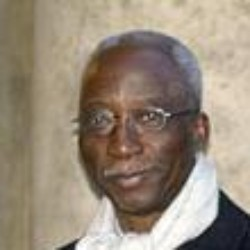
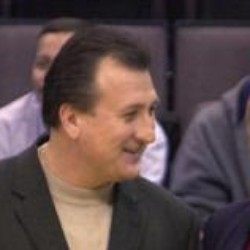
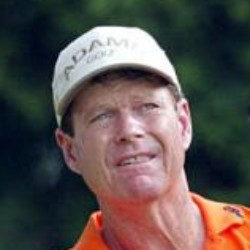
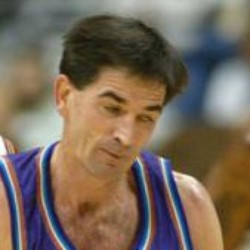

In [12]:
# take a look at those inconsistencies in human detection

arr = np.sum([i["results"] for i in hh], axis=1)
ixs = np.where(arr<3)

print("Showing images with detection discrepancies among models")

images = [hh[ix]["img_path"] for ix in ixs[0]]
labels = [hh[ix]["img_path"].split("\\")[-1] + "</br>" + str(hh[ix]["results"]) for ix in ixs[0]]

gallery(images, labels)

Showing images with detection discrepancies among models, for the dogs sample



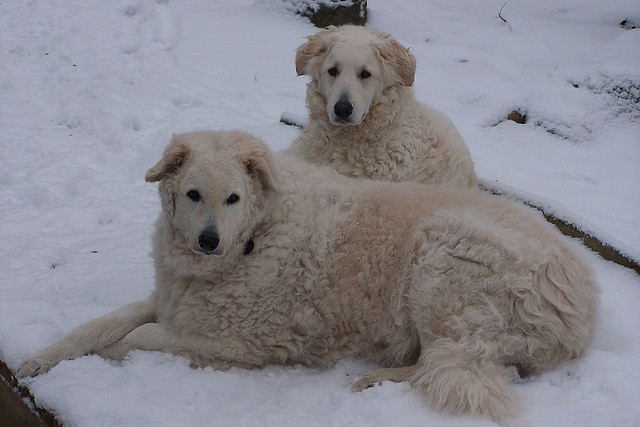
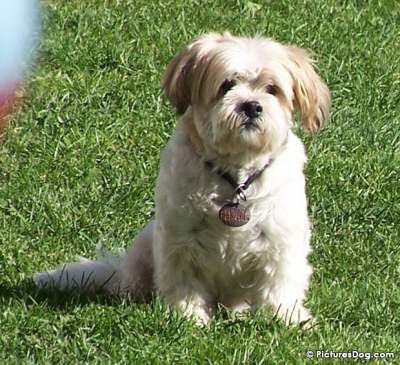
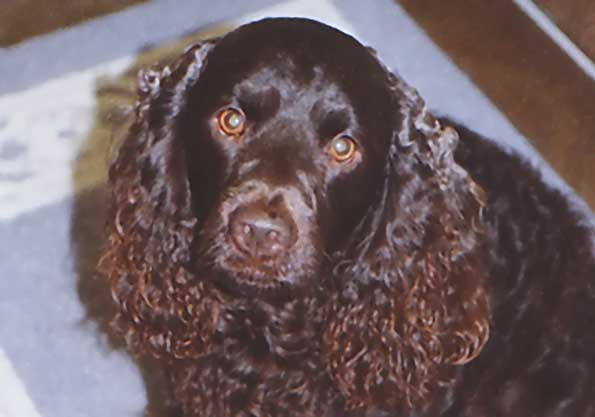
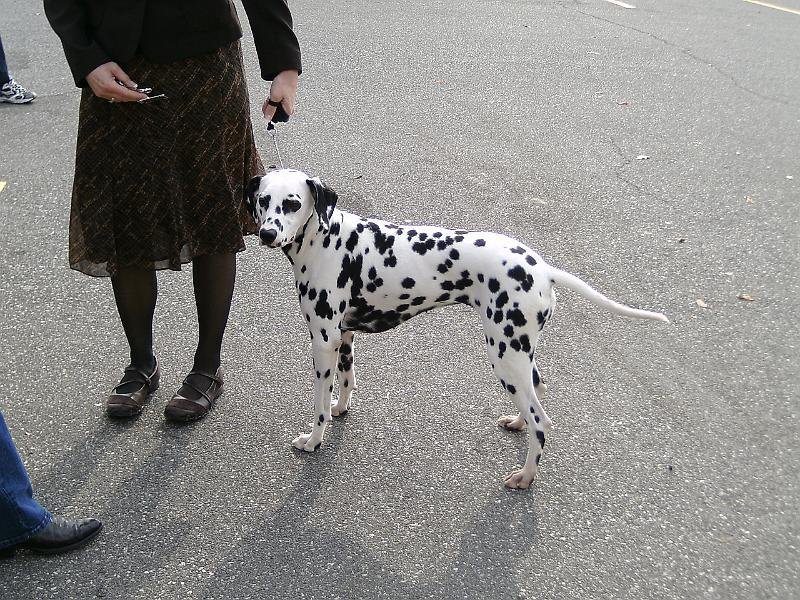
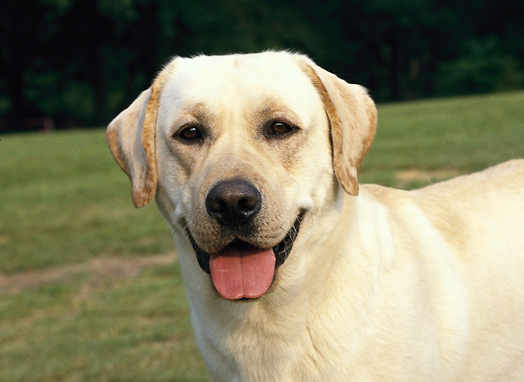
...
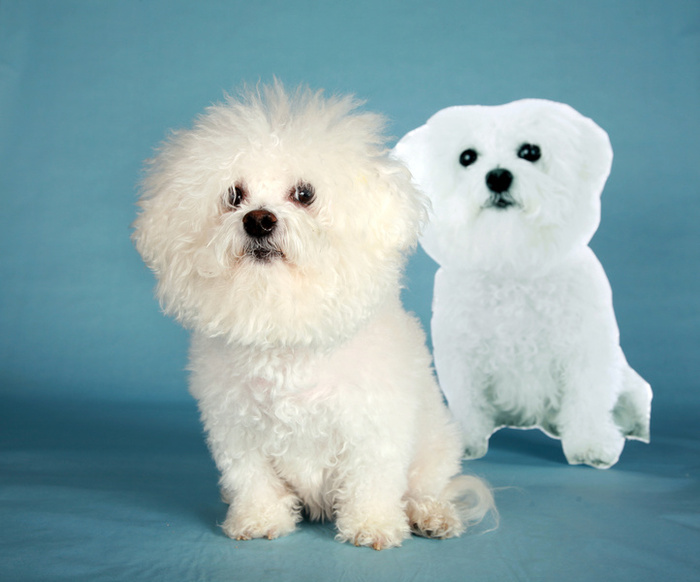
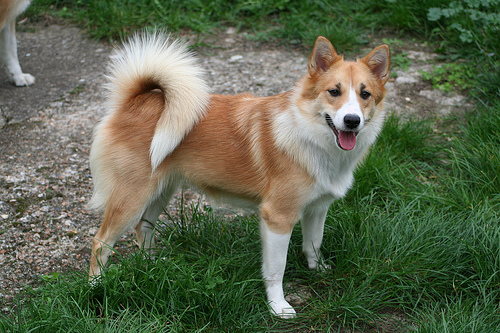
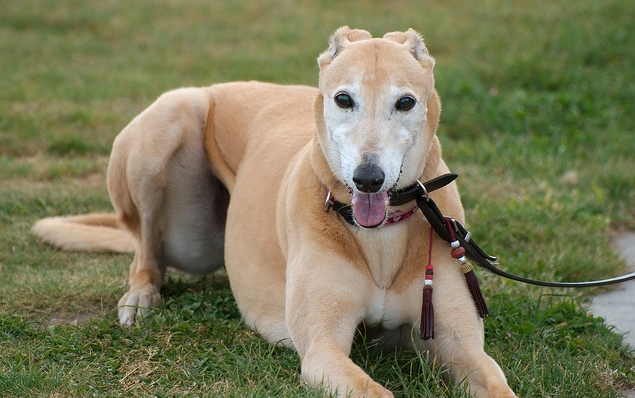
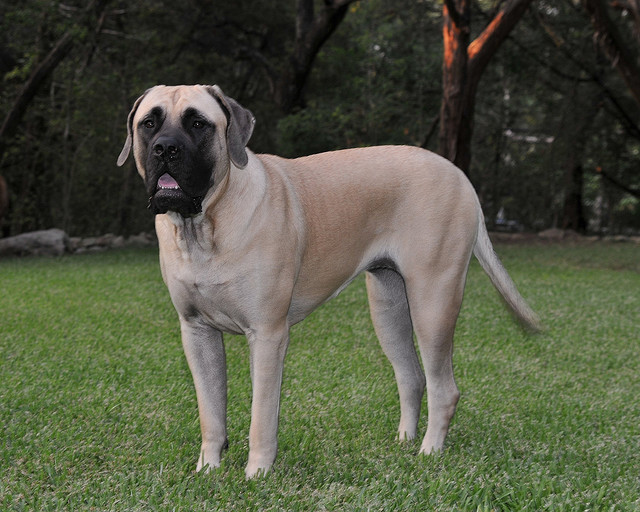
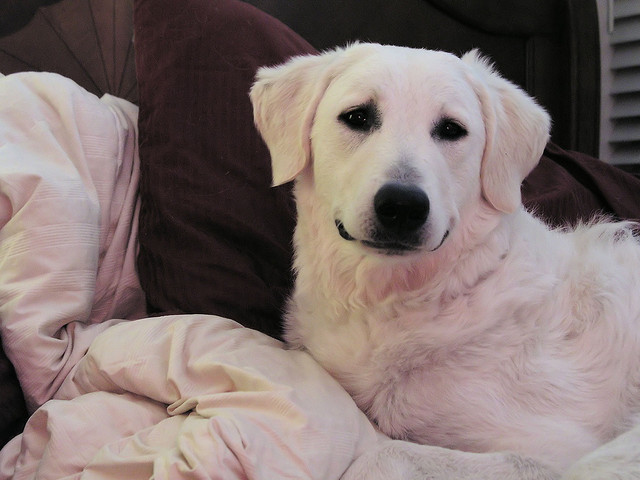

In [13]:
# take a look at those inconsistencies in human in dogs detection

arr = np.sum([i["results"] for i in hd], axis=1)
ixs = np.where(arr>0)

print("Showing images with detection discrepancies among models, for the dogs sample")

images = [hd[ix]["img_path"] for ix in ixs[0]]
labels = [hd[ix]["img_path"].split("\\")[-1] + "</br>" + str(hd[ix]["results"]) for ix in ixs[0]]

gallery(images, labels)

In [14]:
from io import BytesIO
import base64
import PIL
import imutils

In [15]:
# drawing boxes for better inspection

def draw_bow(faces, image_np, text, color):
    '''draw boxes using faces coordinates and annotates text in image'''

    for (x,y,w,h) in faces:
        cv2.rectangle(image_np,(x,y),(x+w,y+h), color,2)
        cv2.putText(image_np, text, (x,y-3), fontFace = cv2.FONT_HERSHEY_PLAIN, fontScale = 1, color = color)

def bboxes(img_path):
        '''implement various face detection models and draw boxes.
        Returns image in a 4-dimensions array (numpy.array).'''
        
        img = cv2.imread(img_path)

        # resize very large images
        if img.shape[0] > 700:
            img = imutils.resize(img, width=700)

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Haar-like
        face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')
        faces = face_cascade.detectMultiScale(gray)
        if len(faces) > 0: 
            draw_bow(faces, img, "haar", (255,0,255))
        
        # HoG
        face_hog = dlib.get_frontal_face_detector()
        rects = face_hog(gray, 1)
        if rects : 
            faces = []
            for d in rects :
                faces.append(face_utils.rect_to_bb(d))
            faces = np.array(faces)
            draw_bow(faces, img, "hog-svm", (255,255,0))
            
        # CNN
        face_cnn = dlib.cnn_face_detection_model_v1("mmod/mmod_human_face_detector.dat")
        rects = face_cnn(img, 1)
        if rects:
            faces = np.array([face_utils.rect_to_bb(rects[0].rect)])
            draw_bow(faces, img, "cnn", (0,255,255))


        return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        
def to_b64(image_array):
    '''transforms nd.array image into b64 string'''

    pil_img = PIL.Image.fromarray(image_array)
    buff = BytesIO()
    pil_img.save(buff, format="PNG")
    b64str = base64.b64encode(buff.getvalue()).decode("utf-8")

    return b64str

100%|██████████████████████████████████████████████████████████████████████████████████| 17/17 [03:45<00:00, 13.26s/it]



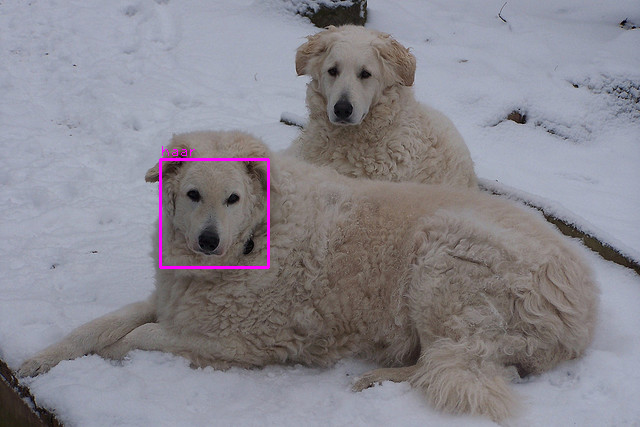
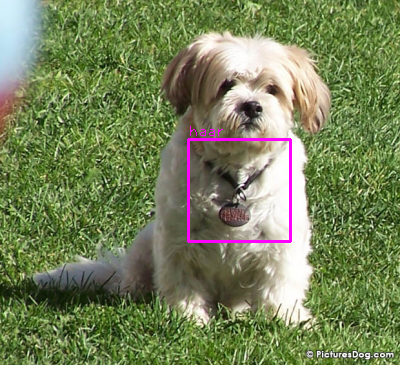
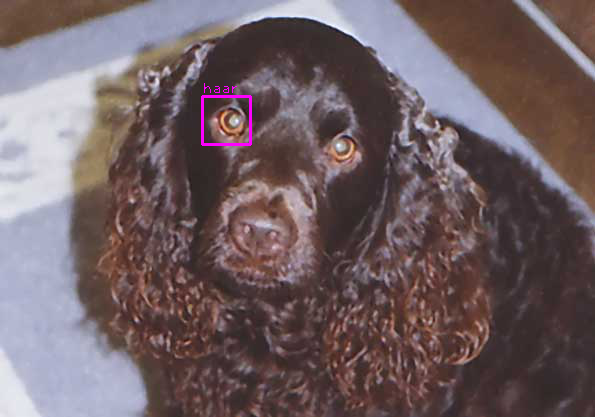
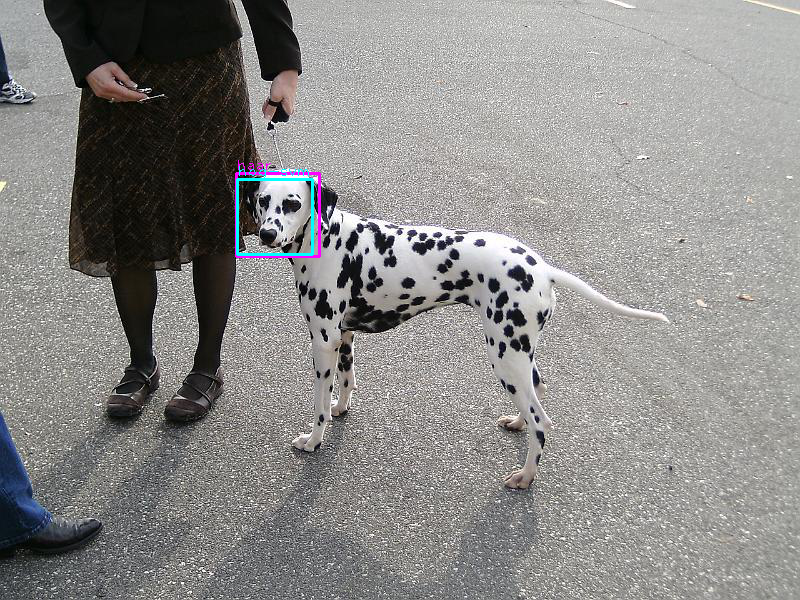
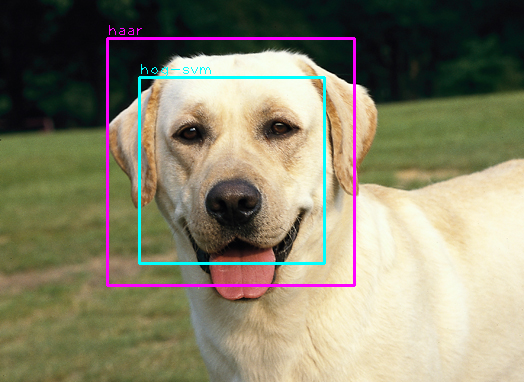
...
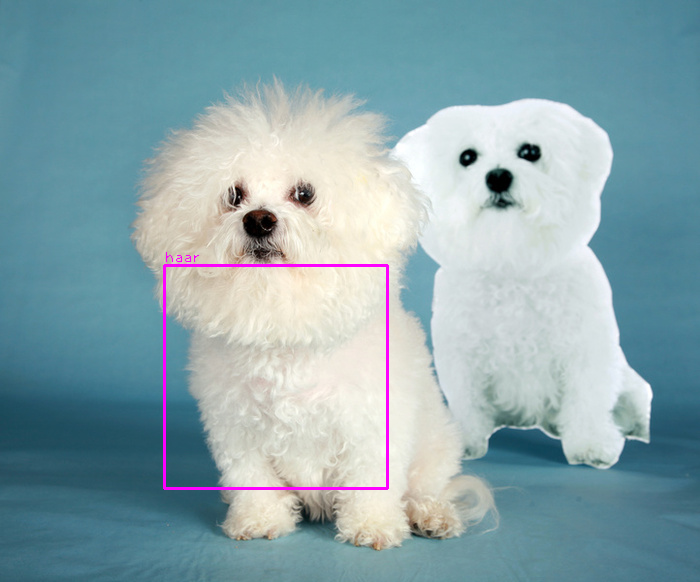
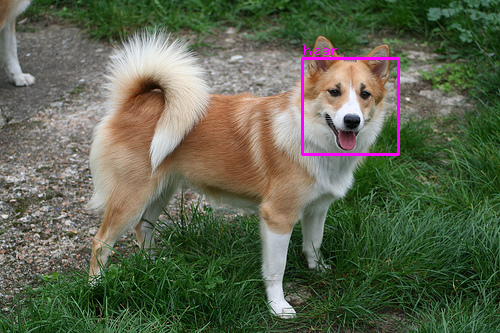
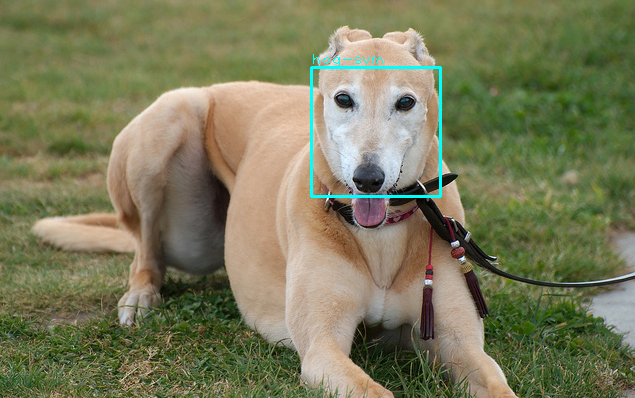
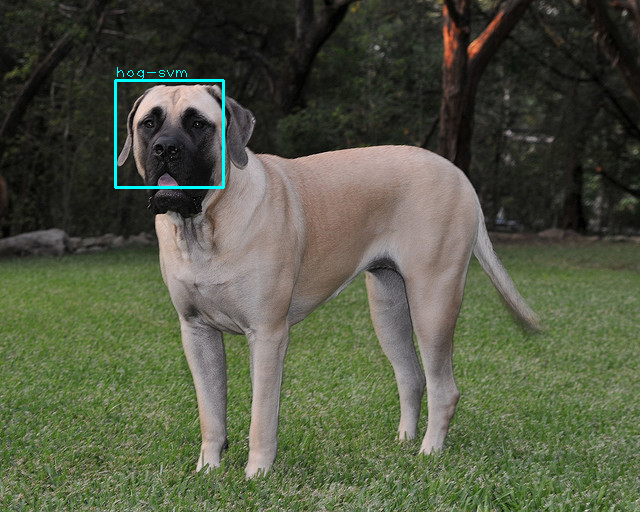
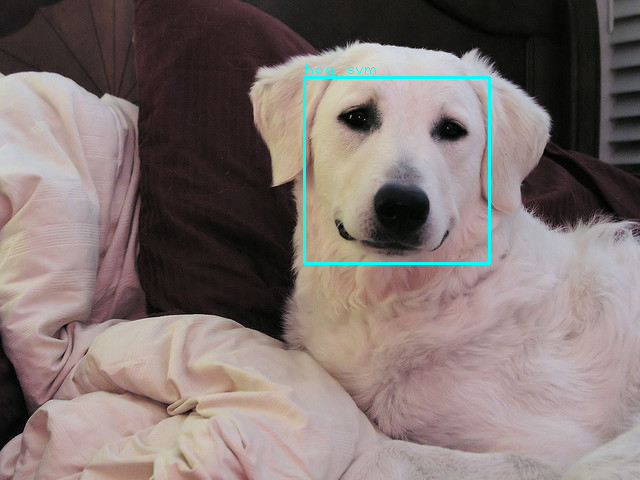

In [16]:
# Run to see some false positives examples.
# ⚠️ this may take a while because of CNN-MMOD's computations times

images_html = ""

for img_path in tqdm(images):

    image_with_bboxes = bboxes(img_path)
    figure_html= "<figure style='height: 300px; margin: 20px 10px; float: left'><img src='{imgsrc}'/></figure>"
    html = figure_html.format(
        imgsrc = 'data:image/jpeg;base64,' + to_b64(image_with_bboxes),
    )
    images_html += html


display(HTML(images_html))

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a pre-trained [ResNet-50](http://ethereon.github.io/netscope/#/gist/db945b393d40bfa26006) model to detect dogs in images.  Our first line of code downloads the ResNet-50 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  Given an image, this pre-trained ResNet-50 model returns a prediction (derived from the available categories in ImageNet) for the object that is contained in the image.

In [18]:
from keras.applications.resnet import ResNet50

# define ResNet50 model
ResNet50_model = ResNet50(weights='imagenet')

### Pre-process the Data

When using TensorFlow as backend, Keras CNNs require a 4D array (which we'll also refer to as a 4D tensor) as input, with shape

$$
(\text{nb-samples}, \text{rows}, \text{columns}, \text{channels})
$$

where `nb_samples` corresponds to the total number of images (or samples), and `rows`, `columns`, and `channels` correspond to the number of rows, columns, and channels for each image, respectively.  

The `path_to_tensor` function below takes a string-valued file path to a color image as input and returns a 4D tensor suitable for supplying to a Keras CNN.  The function first loads the image and resizes it to a square image that is $224 \times 224$ pixels.  Next, the image is converted to an array, which is then resized to a 4D tensor.  In this case, since we are working with color images, each image has three channels.  Likewise, since we are processing a single image (or sample), the returned tensor will always have shape

$$
(1, 224, 224, 3).
$$

The `paths_to_tensor` function takes a numpy array of string-valued image paths as input and returns a 4D tensor with shape 

$$
(\text{nbsamples}, 224, 224, 3).
$$

Here, `nb_samples` is the number of samples, or number of images, in the supplied array of image paths.  It is best to think of `nb_samples` as the number of 3D tensors (where each 3D tensor corresponds to a different image) in your dataset!

In [19]:
import keras
# from tqdm import tqdm

def path_to_tensor(img_path):
    # loads RGB image as PIL.Image.Image type
    img = keras.utils.load_img(img_path, target_size=(224, 224))
    # convert PIL.Image.Image type to 3D tensor with shape (224, 224, 3)
    x = keras.utils.img_to_array(img)
    # convert 3D tensor to 4D tensor with shape (1, 224, 224, 3) and return 4D tensor
    return np.expand_dims(x, axis=0)

def paths_to_tensor(img_paths):
    list_of_tensors = [path_to_tensor(img_path) for img_path in tqdm(img_paths)]

    return np.vstack(list_of_tensors)

In [20]:
path_to_tensor(human_files[0]).shape

(1, 224, 224, 3)

### Making Predictions with ResNet-50

Getting the 4D tensor ready for ResNet-50, and for any other pre-trained model in Keras, requires some additional processing.  First, the RGB image is converted to BGR by reordering the channels.  All pre-trained models have the additional normalization step that the mean pixel (expressed in RGB as $[103.939, 116.779, 123.68]$ and calculated from all pixels in all images in ImageNet) must be subtracted from every pixel in each image.  This is implemented in the imported function `preprocess_input`.  If you're curious, you can check the code for `preprocess_input` [here](https://github.com/fchollet/keras/blob/master/keras/applications/imagenet_utils.py).

Now that we have a way to format our image for supplying to ResNet-50, we are now ready to use the model to extract the predictions.  This is accomplished with the `predict` method, which returns an array whose $i$-th entry is the model's predicted probability that the image belongs to the $i$-th ImageNet category.  This is implemented in the `ResNet50_predict_labels` function below.

By taking the argmax of the predicted probability vector, we obtain an integer corresponding to the model's predicted object class, which we can identify with an object category through the use of this [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a). 

In [77]:
from keras.applications.resnet import ResNet50, preprocess_input, decode_predictions

def ResNet50_predict_labels(img_path):
    # returns prediction vector for image located at img_path
    img = preprocess_input(path_to_tensor(img_path))
    return np.argmax(ResNet50_model.predict(img, verbose=0))    # added verbose=0 for silent

### Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained ResNet-50 model, we need only check if the `ResNet50_predict_labels` function above returns a value between 151 and 268 (inclusive).

We use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [78]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    prediction = ResNet50_predict_labels(img_path)
    return ((prediction <= 268) & (prediction >= 151)) 

### (IMPLEMENTATION) Assess the Dog Detector

__Question 3:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 

<div class="alert alert-block alert-info">
From the test below, we found: 
    
- 0% dog-detection for the human image sample.
- 100% dog-detection for the dog image sample.

</div>

In [79]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

# Loop and store results in list
print("running assessment(s)")

results_dogs_in_humans =[]
results_dogs_in_dogs = []

for img in tqdm(human_files_short): 
    results_dogs_in_humans.append(dog_detector(img))

for img in tqdm(dog_files_short): 
    results_dogs_in_dogs.append(dog_detector(img))

# Print results
print("Percentage of dog-detection in human_files_short :")
print((np.sum(results_dogs_in_humans)/len(human_files_short))*100)

print("Percentage of dog-detection in dog_files_short :")
print((np.sum(results_dogs_in_dogs)/len(dog_files_short))*100)

running assessment(s)


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:11<00:00,  8.96it/s]

Percentage of dog-detection in human_files_short :
0.0
Percentage of dog-detection in dog_files_short :
100.0


---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 1%.  In Step 5 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

Be careful with adding too many trainable layers!  More parameters means longer training, which means you are more likely to need a GPU to accelerate the training process.  Thankfully, Keras provides a handy estimate of the time that each epoch is likely to take; you can extrapolate this estimate to figure out how long it will take for your algorithm to train. 

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have great difficulty in distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun! 

### Pre-process the Data

We rescale the images by dividing every pixel in every image by 255.

In [80]:
from PIL import ImageFile                            
ImageFile.LOAD_TRUNCATED_IMAGES = True
from tqdm import tqdm

# pre-process the data for Keras
train_tensors = paths_to_tensor(train_files).astype('float32')/255
valid_tensors = paths_to_tensor(valid_files).astype('float32')/255
test_tensors = paths_to_tensor(test_files).astype('float32')/255

100%|███████████████████████████████████████████████████████████████████████████████| 836/836 [00:03<00:00, 231.37it/s]


### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  At the end of your code cell block, summarize the layers of your model by executing the line:
    
        model.summary()

We have imported some Python modules to get you started, but feel free to import as many modules as you need.  If you end up getting stuck, here's a hint that specifies a model that trains relatively fast on CPU and attains >1% test accuracy in 5 epochs:

![Sample CNN](images/sample_cnn.png)
           
__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  If you chose to use the hinted architecture above, describe why you think that CNN architecture should work well for the image classification task.

__Answer:__ 

<div class="alert alert-block alert-info">
Since this is an image problem, it makes sense that we go por spatial convolution techniques.    
    
We choose a simple architecture to keep the computation times to the minimum. I found out that three 2D convolutional layers where enough to get a good steady evolution between epochs. The number of output filters per convolutional layer was kept low (16 => 32 => 16), with no significant difference when increased. 
A traditional 3x3 kernel size provided a good starting point. All convolutional layers where equiped with the ReLU activation and used padding in order to keep the dimensions aligned.
    
Image flip was not sufficiently tested, but initials runs suggested that horizontal flipping provided no significant improvement.
    
A final dense layer used the softmax activation function (better suited for single-label classification outputs) and a size of 133 (number of classes).
    
Dropout layers did not provide any considerable improvement to our model. 
Flattening Layers provided a initial jump in accuracy only after 2 epochs, but are discarded for adding considerable overfitting afterwards. We choose a Global Average Pooling layer instead.

<b>See notes on implementation below</b>
    
</div>

In [27]:
import keras
from tensorflow.keras import layers

### TODO: Define your architecture.

inputs = keras.Input(shape=((224, 224, 3)))

# best one overall
model = keras.Sequential(
    [
        inputs,
                
        layers.Conv2D(16, kernel_size=3, activation='relu'),
        layers.MaxPooling2D(pool_size=3, strides=2),
        
        layers.Conv2D(32, kernel_size=3, activation='relu', padding="same"),
        layers.MaxPooling2D(pool_size=3, strides=2),
        
        layers.Conv2D(16, kernel_size=3, activation='relu', padding="same"),
        layers.MaxPooling2D(pool_size=3, strides=2),
        
        layers.GlobalAveragePooling2D(),
        layers.Dense(units=133, activation="softmax")    #sigmoid or softmax are suited for multiple classes
    ]
)


model.summary(line_length=90)



Model: "sequential_1"
__________________________________________________________________________________________
 Layer (type)                           Output Shape                        Param #       
 conv2d (Conv2D)                        (None, 222, 222, 16)                448           
                                                                                          
 max_pooling2d (MaxPooling2D)           (None, 110, 110, 16)                0             
                                                                                          
 conv2d_1 (Conv2D)                      (None, 110, 110, 32)                4640          
                                                                                          
 max_pooling2d_1 (MaxPooling2D)         (None, 54, 54, 32)                  0             
                                                                                          
 conv2d_2 (Conv2D)                      (None, 54, 54, 16)          

### Compile the Model

In [28]:
model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['accuracy'])

### (IMPLEMENTATION) Train the Model

Train your model in the code cell below.  Use model checkpointing to save the model that attains the best validation loss.

You are welcome to [augment the training data](https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html), but this is not a requirement. 

<div class="alert alert-block alert-info">

When trained for 40 epochs, the model showed slow but steady learning progress overall. Signs of overfitting are starting to show starting from 25 epochs. However, we might want to train the model longer to confirm this. <b>We attained a test accuracy of 12.2% with this model.</b> This was achieved while keeping loss and accuracy as close as possible to their validation counterparts. The rollign loss and accuracy are plotted below.
    
</div>

In [55]:
import datetime

### TODO: specify the number of epochs that you would like to use to train the model.

epochs = 50

### Do NOT modify the code below this line.

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath='saved_models/weights.best.from_scratch.hdf5',
        verbose=1,
        save_best_only=True
    ),
    keras.callbacks.TensorBoard(
        log_dir = log_dir
    )
]

hist = model.fit(
    train_tensors, 
    train_targets, 
    validation_data=(valid_tensors, valid_targets),
    epochs=epochs, 
    batch_size=20, 
    callbacks=callbacks, 
    verbose=1
)

Epoch 1/50
334/334 [==============================] - ETA: 0s - loss: 4.8816 - accuracy: 0.0103
Epoch 1: val_loss improved from inf to 4.86501, saving model to saved_models\weights.best.from_scratch.hdf5
334/334 [==============================] - 30s 87ms/step - loss: 4.8816 - accuracy: 0.0103 - val_loss: 4.8650 - val_accuracy: 0.0180
Epoch 2/50
334/334 [==============================] - ETA: 0s - loss: 4.8433 - accuracy: 0.0129
Epoch 2: val_loss improved from 4.86501 to 4.82942, saving model to saved_models\weights.best.from_scratch.hdf5
334/334 [==============================] - 35s 105ms/step - loss: 4.8433 - accuracy: 0.0129 - val_loss: 4.8294 - val_accuracy: 0.0204
Epoch 3/50
334/334 [==============================] - ETA: 0s - loss: 4.8010 - accuracy: 0.0153
Epoch 3: val_loss improved from 4.82942 to 4.78743, saving model to saved_models\weights.best.from_scratch.hdf5
334/334 [==============================] - 32s 95ms/step - loss: 4.8010 - accuracy: 0.0153 - val_loss: 4.7874 - v

In [36]:
def plot_loss_acc(hist, title):
    '''plot loss and accuracy of model history object (keras.model.hist)'''
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    fig.suptitle(title, fontsize=16)
    
    ax1.plot(hist.history["loss"], c="teal", label="loss")
    ax1.plot(hist.history["val_loss"], c="teal", label="val_loss", ls="--")
    ax1.set_title('Loss')
    ax1.legend(loc="upper right")
    
    ax2.plot(hist.history["accuracy"], c="orange", label="accuracy")
    ax2.plot(hist.history["val_accuracy"], c="orange", label="val_accuracy", ls="--")
    ax2.set_title('Accuracy')
    ax2.legend(loc="upper left")

    plt.show()

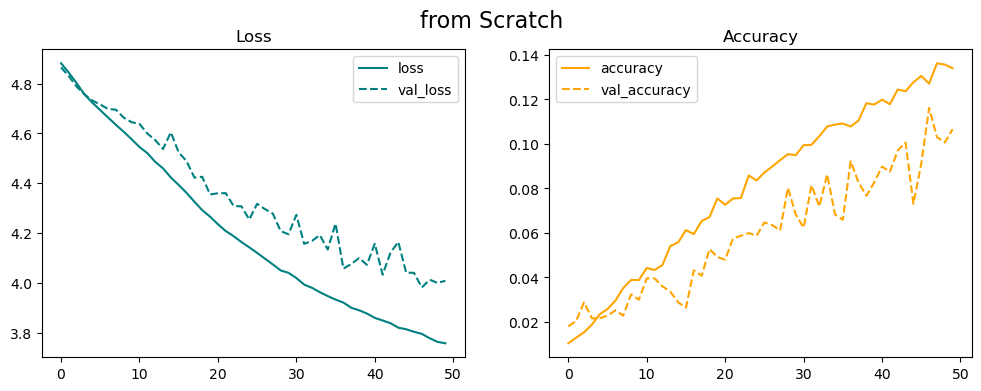

In [57]:
plot_loss_acc(hist, "Dog Breed classifier training (from Scratch)")

### Load the Model with the Best Validation Loss

In [59]:
model.load_weights('saved_models/weights.best.from_scratch.hdf5')

### Test the Model

Try out your model on the test dataset of dog images.  Ensure that your test accuracy is greater than 1%.

In [60]:
# get index of predicted dog breed for each image in test set
dog_breed_predictions = [np.argmax(model.predict(np.expand_dims(tensor, axis=0), verbose=0)) for tensor in tqdm(test_tensors)]

# report test accuracy
test_accuracy = 100*np.sum(np.array(dog_breed_predictions)==np.argmax(test_targets, axis=1))/len(dog_breed_predictions)
print('Test accuracy: %.4f%%' % test_accuracy)

100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 17.86it/s]

Test accuracy: 12.2010%


<div class="alert alert-block alert-info">

After 50 epochs, we attained a test accuracy of 12.2% with this small model.
    
</div>

---
<a id='step4'></a>
## Step 4: Use a CNN to Classify Dog Breeds

To reduce training time without sacrificing accuracy, we show you how to train a CNN using transfer learning.  In the following step, you will get a chance to use transfer learning to train your own CNN.

### Obtain Bottleneck Features

In [29]:
bottleneck_features = np.load('bottleneck_features/DogVGG16Data.npz')
train_VGG16 = bottleneck_features['train']
valid_VGG16 = bottleneck_features['valid']
test_VGG16 = bottleneck_features['test']

### Model Architecture

The model uses the the pre-trained VGG-16 model as a fixed feature extractor, where the last convolutional output of VGG-16 is fed as input to our model.  We only add a global average pooling layer and a fully connected layer, where the latter contains one node for each dog category and is equipped with a softmax.

In [30]:
from keras import layers

VGG16_model = keras.Sequential()
VGG16_model.add(layers.GlobalAveragePooling2D(input_shape=train_VGG16.shape[1:]))
VGG16_model.add(layers.Dense(133, activation='softmax'))

VGG16_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_1   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_1 (Dense)             (None, 133)               68229     
                                                                 
Total params: 68,229
Trainable params: 68,229
Non-trainable params: 0
_________________________________________________________________


### Compile the Model

In [87]:
VGG16_model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])

### Train the Model

In [88]:
checkpointer = keras.callbacks.ModelCheckpoint(filepath='saved_models/weights.best.VGG16.hdf5', 
                               verbose=1, save_best_only=True)

VGG16_model.fit(train_VGG16, train_targets, 
          validation_data=(valid_VGG16, valid_targets),
          epochs=20, batch_size=20, callbacks=[checkpointer], verbose=1)

Epoch 1/20
311/334 [==========================>...] - ETA: 0s - loss: 8.1269 - accuracy: 0.2209
Epoch 1: val_loss improved from inf to 3.37334, saving model to saved_models\weights.best.VGG16.hdf5
334/334 [==============================] - 1s 2ms/step - loss: 7.8087 - accuracy: 0.2347 - val_loss: 3.3733 - val_accuracy: 0.4479
Epoch 2/20
314/334 [===========================>..] - ETA: 0s - loss: 2.1499 - accuracy: 0.5930
Epoch 2: val_loss improved from 3.37334 to 2.27155, saving model to saved_models\weights.best.VGG16.hdf5
334/334 [==============================] - 0s 1ms/step - loss: 2.1186 - accuracy: 0.5996 - val_loss: 2.2716 - val_accuracy: 0.6108
Epoch 3/20
322/334 [===========================>..] - ETA: 0s - loss: 1.2170 - accuracy: 0.7410
Epoch 3: val_loss improved from 2.27155 to 2.02929, saving model to saved_models\weights.best.VGG16.hdf5
334/334 [==============================] - 0s 1ms/step - loss: 1.2130 - accuracy: 0.7422 - val_loss: 2.0293 - val_accuracy: 0.6575
Epoch 4/

### Load the Model with the Best Validation Loss

In [31]:
VGG16_model.load_weights('saved_models/weights.best.VGG16.hdf5')

### Test the Model

Now, we can use the CNN to test how well it identifies breed within our test dataset of dog images.  We print the test accuracy below.

In [90]:
# get index of predicted dog breed for each image in test set
VGG16_predictions = [np.argmax(VGG16_model.predict(np.expand_dims(feature, axis=0), verbose=0)) for feature in tqdm(test_VGG16)]

# report test accuracy
test_accuracy = 100*np.sum(np.array(VGG16_predictions)==np.argmax(test_targets, axis=1))/len(VGG16_predictions)
print('Test accuracy: %.4f%%' % test_accuracy)

100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 18.05it/s]

Test accuracy: 73.5646%


### Predict Dog Breed with the Model

In [32]:
from extract_bottleneck_features import *

def VGG16_predict_breed(img_path):
    # extract bottleneck features
    bottleneck_feature = extract_VGG16(path_to_tensor(img_path))
    # obtain predicted vector
    predicted_vector = VGG16_model.predict(bottleneck_feature, verbose=1)
    # return dog breed that is predicted by the model
    return dog_names[np.argmax(predicted_vector)]

dogImages/train\095.Kuvasz\Kuvasz_06442.jpg


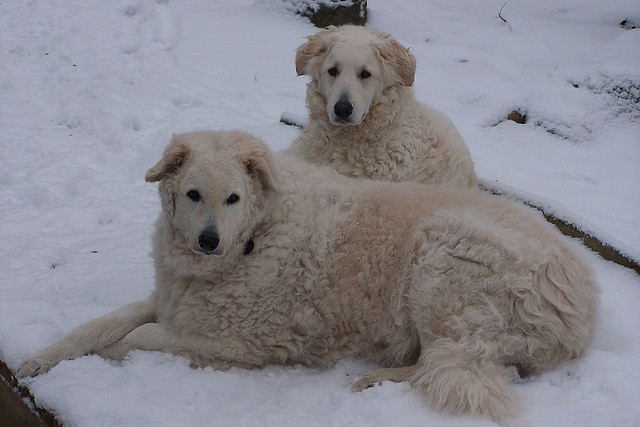

1/1 [==============================] - 0s 59ms/step
Prediction: Kuvasz


In [33]:
for img in dog_files_short[:1] :
    print(img)
    display(Image(img))
    pred = VGG16_predict_breed(img)
    print("Prediction:", pred)

---
<a id='step5'></a>
## Step 5: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

In Step 4, we used transfer learning to create a CNN using VGG-16 bottleneck features.  In this section, you must use the bottleneck features from a different pre-trained model.  To make things easier for you, we have pre-computed the features for all of the networks that are currently available in Keras:
- [VGG-19](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogVGG19Data.npz) bottleneck features
- [ResNet-50](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogResnet50Data.npz) bottleneck features
- [Inception](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogInceptionV3Data.npz) bottleneck features
- [Xception](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogXceptionData.npz) bottleneck features

The files are encoded as such:

    Dog{network}Data.npz
    
where `{network}`, in the above filename, can be one of `VGG19`, `Resnet50`, `InceptionV3`, or `Xception`.  Pick one of the above architectures, download the corresponding bottleneck features, and store the downloaded file in the `bottleneck_features/` folder in the repository.

### (IMPLEMENTATION) Obtain Bottleneck Features

In the code block below, extract the bottleneck features corresponding to the train, test, and validation sets by running the following:

    bottleneck_features = np.load('bottleneck_features/Dog{network}Data.npz')
    train_{network} = bottleneck_features['train']
    valid_{network} = bottleneck_features['valid']
    test_{network} = bottleneck_features['test']

In [34]:
### TODO: Obtain bottleneck features from another pre-trained CNN.

# These bottleneck files where downloaded separately and stored in bottleneck_features/

# https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogVGG19Data.npz
# https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogResnet50Data.npz
# https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogInceptionV3Data.npz
# https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/DogXceptionData.npz

# load bottleneck features for all four pretrained networks

networks_pretrained= []

for network in ["VGG19", "ResNet50", "Xception", "InceptionV3"]:
    bnf_path = 'bottleneck_features/Dog{}Data.npz'.format(network)
    print("{:15} loading {} ...".format(network, bnf_path))
    bottleneck_features = np.load(bnf_path)
    d = {
        "network": network,
        "train": bottleneck_features['train'],
        "valid": bottleneck_features['valid'],
        "test": bottleneck_features['test']
    }
    
    networks_pretrained.append(d)

VGG19           loading bottleneck_features/DogVGG19Data.npz ...
ResNet50        loading bottleneck_features/DogResNet50Data.npz ...
Xception        loading bottleneck_features/DogXceptionData.npz ...
InceptionV3     loading bottleneck_features/DogInceptionV3Data.npz ...


Model: "VGG19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_3   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_3 (Dense)             (None, 133)               68229     
                                                                 
Total params: 68,229
Trainable params: 68,229
Non-trainable params: 0
_________________________________________________________________
VGG19           compiling ...
VGG19           training model ...


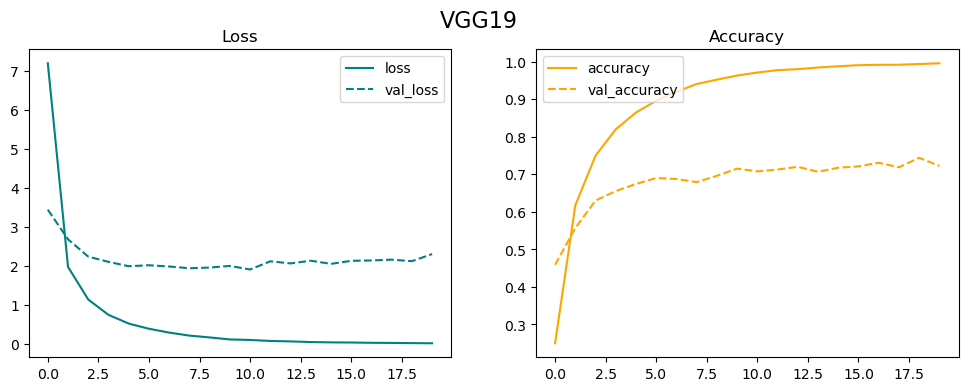

Model: "ResNet50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_4   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_4 (Dense)             (None, 133)               272517    
                                                                 
Total params: 272,517
Trainable params: 272,517
Non-trainable params: 0
_________________________________________________________________
ResNet50        compiling ...
ResNet50        training model ...


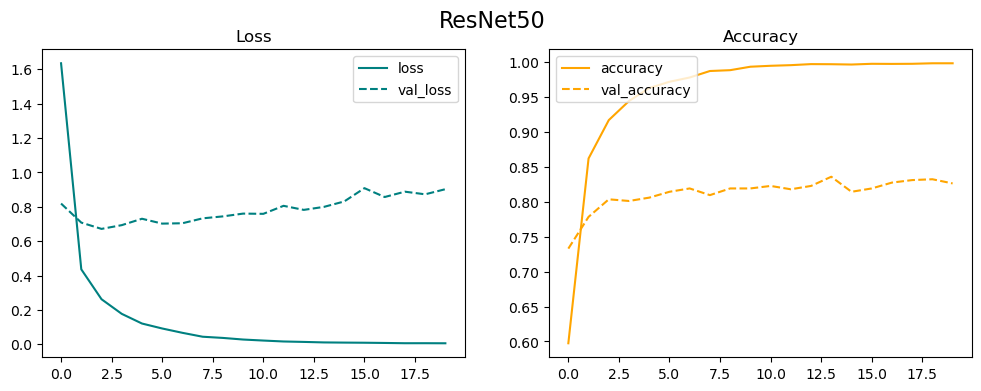

Model: "Xception"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_5   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_5 (Dense)             (None, 133)               272517    
                                                                 
Total params: 272,517
Trainable params: 272,517
Non-trainable params: 0
_________________________________________________________________
Xception        compiling ...
Xception        training model ...


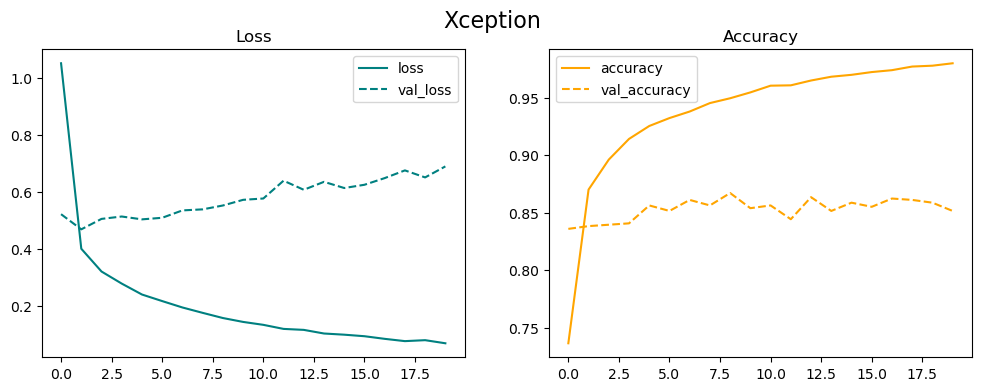

Model: "InceptionV3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_6   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_6 (Dense)             (None, 133)               272517    
                                                                 
Total params: 272,517
Trainable params: 272,517
Non-trainable params: 0
_________________________________________________________________
InceptionV3     compiling ...
InceptionV3     training model ...


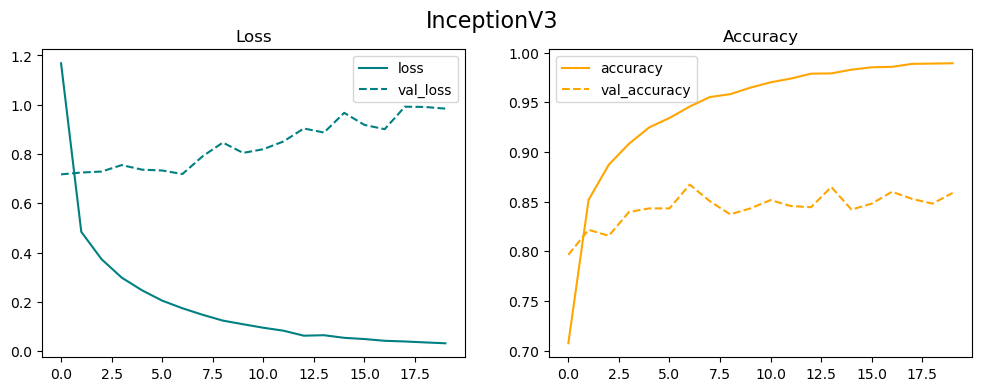

In [37]:
# Loop : for each network, add the same basic layers, compile and fit

for n in networks_pretrained :
    name = n["network"]
    model = keras.Sequential(name = name)
    input_shape = n["train"].shape[1:]

    model.add(layers.GlobalAveragePooling2D(input_shape=input_shape))
    model.add(layers.Dense(133, activation='softmax'))
    model.summary()
    
    print("{:15} compiling ...".format(name))
    model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])
    
    print("{:15} training model ...".format(name))
    checkpointer = keras.callbacks.ModelCheckpoint(
        filepath='saved_models/weights.best.{}.hdf5'.format(name), 
        verbose=0, 
        save_best_only=True
    )
    
    n["model"] = model
    
    # fit for 30 epochs
    n["hist"] = model.fit(
        n["train"], 
        train_targets, 
        validation_data=(n["valid"], valid_targets),
        epochs=20, 
        batch_size=20, 
        callbacks=[checkpointer], 
        verbose=0)
    
    # print for insight
    plot_loss_acc(n["hist"], n["network"])

In [104]:
# Loop : test all predictions and compare

for n in networks_pretrained :
    
    # load best weights from file
    n["model"].load_weights('saved_models/weights.best.{}.hdf5'.format(n["network"]))
    
    print("{:15} Testing ...".format(n["network"]))
    # get index of predicted dog breed for each image in test set
    predictions = [np.argmax(n["model"].predict(np.expand_dims(feature, axis=0), verbose=0)) for feature in tqdm(n["test"])]

    # report test accuracy
    test_accuracy = 100*np.sum(np.array(predictions)==np.argmax(test_targets, axis=1))/len(predictions)
    print(n["network"], 'Test accuracy: %.4f%%' % test_accuracy)

VGG19           Testing ...


100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 18.02it/s]


VGG19 Test accuracy: 72.2488%
ResNet50        Testing ...


100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 17.94it/s]


ResNet50 Test accuracy: 81.1005%
Xception        Testing ...


100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 18.10it/s]


Xception Test accuracy: 84.2105%
InceptionV3     Testing ...


100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:46<00:00, 18.07it/s]

InceptionV3 Test accuracy: 79.1866%


### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  At the end of your code cell block, summarize the layers of your model by executing the line:
    
        <your model's name>.summary()
   
__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__

<div class="alert alert-block alert-info">
Architecture : Since we already have a pre-processed set of Dog bottleneck features for Xception, we will only add two top layers : 
    - A global spatial average pooling layer (GlobalAveragePooling2D).
    - A fully connected layer (Dense) designed to distinguish between the 133 breeds.
</div>


In [38]:
### TODO: Define your architecture.

# get bottleneck features from Xception from file
Xception_bottleneck_features = np.load('bottleneck_features/DogXceptionData.npz')
Xception_train = Xception_bottleneck_features['train']
Xception_valid = Xception_bottleneck_features['valid']
Xception_test = Xception_bottleneck_features['test']

# # Configure input and add layers : 
# # Note this one gives acc 84% after 3-4 epochs
model = keras.Sequential(name = "Xception-final")

# add a global spatial average pooling layer.
# add a fully-connected layer designed to distinguish between the 133 breeds.

model.add(layers.GlobalAveragePooling2D(input_shape=Xception_train.shape[1:]))
model.add(layers.Dense(133, activation='softmax'))

# Print summary
model.summary()

Model: "Xception-final"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_7   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_7 (Dense)             (None, 133)               272517    
                                                                 
Total params: 272,517
Trainable params: 272,517
Non-trainable params: 0
_________________________________________________________________


### (IMPLEMENTATION) Compile the Model

In [39]:
### TODO: Compile the model.
model.compile(loss='categorical_crossentropy', optimizer='rmsprop', metrics=['accuracy'])
# model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

### (IMPLEMENTATION) Train the Model

Train your model in the code cell below.  Use model checkpointing to save the model that attains the best validation loss.  

You are welcome to [augment the training data](https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html), but this is not a requirement. 

Xception-final
Epoch 1/10
324/334 [============================>.] - ETA: 0s - loss: 1.0726 - accuracy: 0.7341
Epoch 1: val_loss improved from inf to 0.51898, saving model to saved_models\weights.best.Xception-final.hdf5
334/334 [==============================] - 2s 4ms/step - loss: 1.0573 - accuracy: 0.7362 - val_loss: 0.5190 - val_accuracy: 0.8311
Epoch 2/10
319/334 [===========================>..] - ETA: 0s - loss: 0.3997 - accuracy: 0.8730
Epoch 2: val_loss improved from 0.51898 to 0.49622, saving model to saved_models\weights.best.Xception-final.hdf5
334/334 [==============================] - 2s 5ms/step - loss: 0.3974 - accuracy: 0.8738 - val_loss: 0.4962 - val_accuracy: 0.8395
Epoch 3/10
328/334 [============================>.] - ETA: 0s - loss: 0.3205 - accuracy: 0.9026
Epoch 3: val_loss did not improve from 0.49622
334/334 [==============================] - 1s 4ms/step - loss: 0.3200 - accuracy: 0.9028 - val_loss: 0.5127 - val_accuracy: 0.8515
Epoch 4/10
332/334 [=============

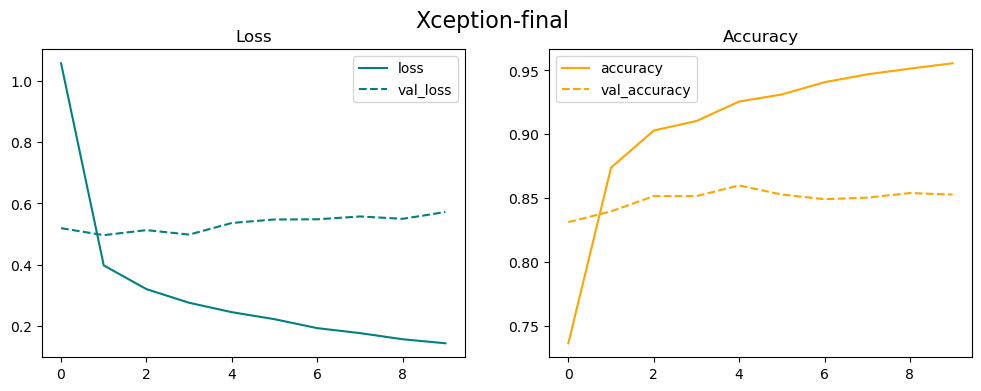

In [40]:
# ### TODO: Train the model.
print(model.name)

checkpointer = keras.callbacks.ModelCheckpoint(
    filepath='saved_models/weights.best.{}.hdf5'.format(model.name), 
    verbose=1, 
    save_best_only=True
)

hist = model.fit(
    Xception_train, train_targets, 
    validation_data=(
        Xception_valid, 
        valid_targets),
    epochs=10,
    batch_size=20, 
    callbacks=[checkpointer], 
    verbose=1
)

# plot loss and accuracy 
plot_loss_acc(hist, model.name)

### (IMPLEMENTATION) Load the Model with the Best Validation Loss

In [ ]:
### TODO: Load the model weights with the best validation loss.
model.load_weights('saved_models/weights.best.Xception-final.hdf5')

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Ensure that your test accuracy is greater than 60%.

In [22]:
### TODO: Calculate classification accuracy on the test dataset.

# get index of predicted dog breed for each image in test set
predictions = [np.argmax(model.predict(np.expand_dims(feature, axis=0), verbose=0)) for feature in tqdm(Xception_test)]

# report test accuracy
test_accuracy = 100*np.sum(np.array(predictions)==np.argmax(test_targets, axis=1))/len(predictions)
print(model.name, ' test accuracy: %.4f%%' % test_accuracy)

100%|████████████████████████████████████████████████████████████████████████████████| 836/836 [00:33<00:00, 25.12it/s]

Xception-final  test accuracy: 0.0000%


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan_hound`, etc) that is predicted by your model.  

Similar to the analogous function in Step 5, your function should have three steps:
1. Extract the bottleneck features corresponding to the chosen CNN model.
2. Supply the bottleneck features as input to the model to return the predicted vector.  Note that the argmax of this prediction vector gives the index of the predicted dog breed.
3. Use the `dog_names` array defined in Step 0 of this notebook to return the corresponding breed.

The functions to extract the bottleneck features can be found in `extract_bottleneck_features.py`, and they have been imported in an earlier code cell.  To obtain the bottleneck features corresponding to your chosen CNN architecture, you need to use the function

    extract_{network}
    
where `{network}`, in the above filename, should be one of `VGG19`, `Resnet50`, `InceptionV3`, or `Xception`.

Xception-final  predictions...
1/1 [==============================] - 1s 629ms/step



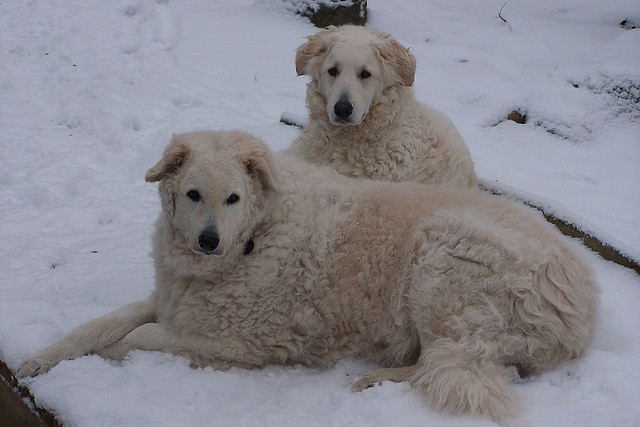
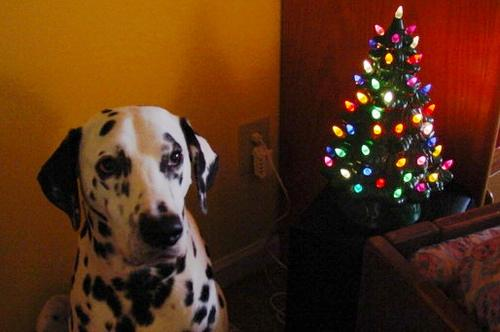
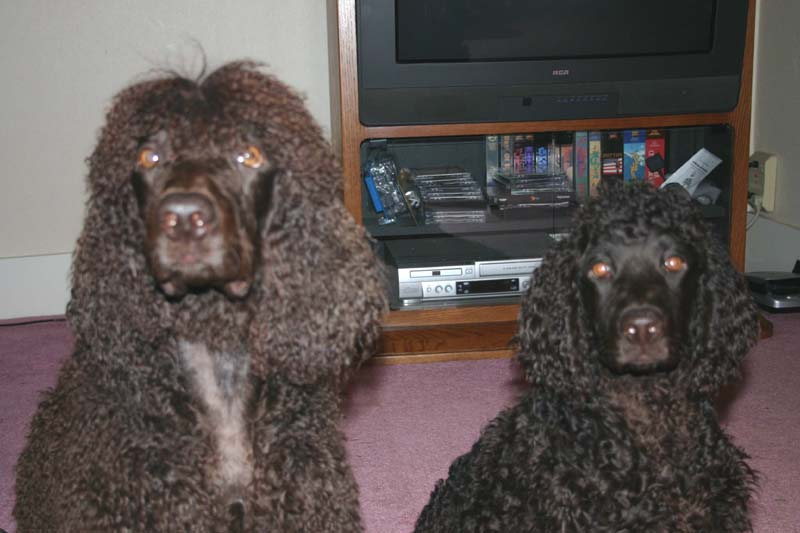
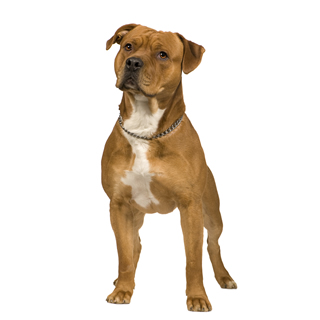
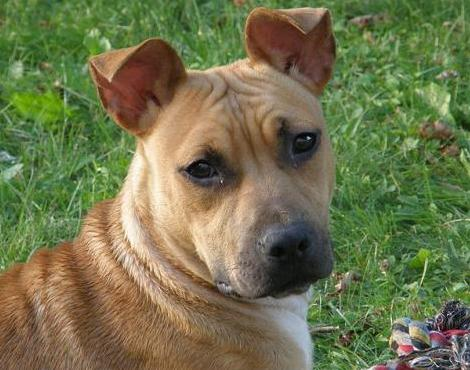
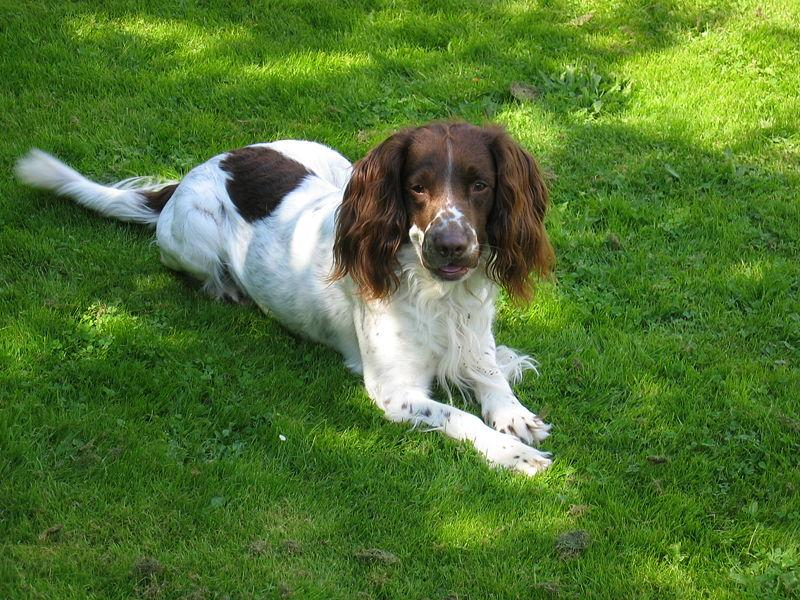
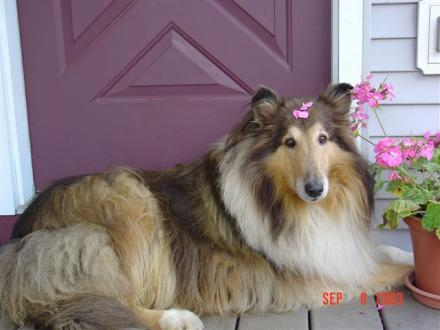
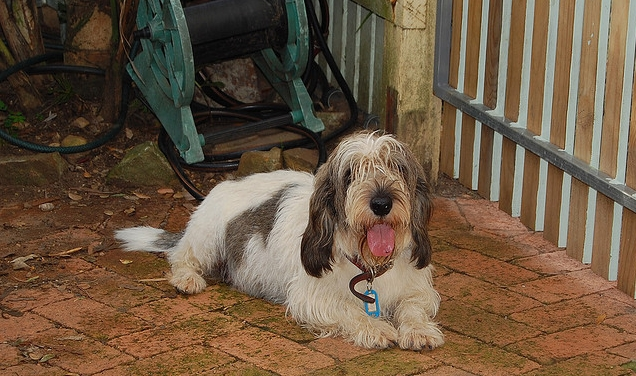
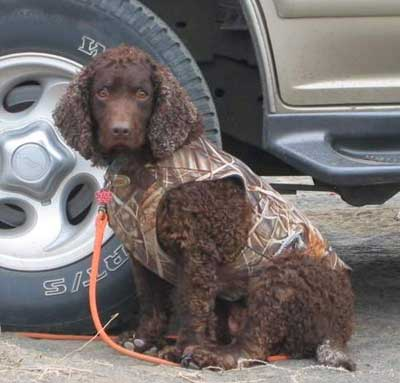
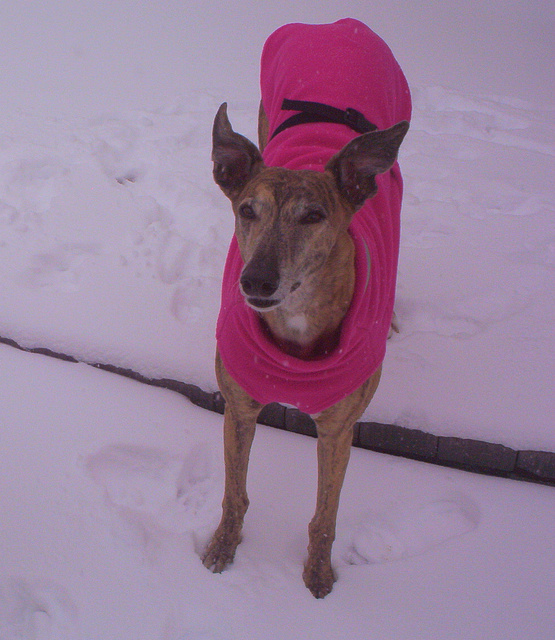

In [42]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

print(model.name, " predictions...")

def final_model_predict_breed(img_path):
    '''Extract features using built-in keras Xception module 
    Then do the prediction with our model and return dog breed using 
    dog_names labels.'''
    
    # load labels
    dog_names = [item[20:-1] for item in sorted(glob("dogImages/train/*/"))]
    
    # load feature extraction model Xception
    bottleneck_feature = extract_Xception(path_to_tensor(img_path))
    
    # load weights and make predictions
    model.load_weights('saved_models/weights.best.Xception-final.hdf5')
    predicted_vector = model.predict(bottleneck_feature, verbose=0)
    
    return dog_names[np.argmax(predicted_vector)]


# run and show some predictions :)
dog_files_mini = dog_files_short[:10]

preds = [final_model_predict_breed(img) for img in dog_files_mini]
fig_labels = ['file: {}<br>prediction: {}'.format(f.split('\\')[-1],p) for f,p in zip(dog_files_mini, preds)]
gallery(dog_files_mini, fig_labels)

---
<a id='step6'></a>
## Step 6: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `dog_detector` functions developed above.  You are __required__ to use your CNN from Step 5 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [43]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

def find_human(img_arr, algorithm="dlib-cnn"):
    '''Uses CNN-MMOD algorithm to detect human faces in img_arr.
    Returns face position if a human face is found, otherwise returns False'''
    
    import cv2
    import imutils
    from dlib import cnn_face_detection_model_v1

    if algorithm == "dlib-cnn":
        # more accurate, but slow, this detector is used by default
        # print('using dlib cnn model for human detection...')
        face_cnn = cnn_face_detection_model_v1("mmod/mmod_human_face_detector.dat") 
        rects = face_cnn(img_arr, 1)

        if len(rects) > 0:
            # we are only getting one human face (rects[0])
            face = imutils.face_utils.rect_to_bb(rects[0].rect)
            # face = tuple([int(resize_ratio*x) for x in face])
            confidence = rects[0].confidence
            return face, confidence
        else:
            return None
        
    if algorithm == "hog" :
        # algorithm HoG, this one is faster but has higher error.
        # print('using hog-svm for human detection...')
        gray = gray = cv2.cvtColor(img_arr, cv2.COLOR_BGR2GRAY)
        face_hog = dlib.get_frontal_face_detector()
        rects = face_hog(gray, 1)
        
        if rects : 
            face = imutils.face_utils.rect_to_bb(rects[0])
            confidence = 1.0
            return face, confidence
        
        else:
            return None
    
        
def ResNet50_predict_labels(img_path):
    '''Returns prediction vector for image located at img_path.'''
    
    from keras.applications.resnet import ResNet50 
    from keras.applications.resnet import preprocess_input 
    from keras.applications.resnet import decode_predictions

    img = preprocess_input(path_to_tensor(img_path))
    return np.argmax(ResNet50_model.predict(img, verbose=0))


def find_dog(img_path):
    '''Returns True if a dog is detected in the image stored at img_path.'''
    
    prediction = ResNet50_predict_labels(img_path)
    return ((prediction <= 268) & (prediction >= 151)) 


def find_dogbreed(img_path):
    '''Extract features using built-in keras Xception module 
    Then do the prediction with our model and return dog breed using 
    dog_names labels.'''
    
    # load labels
    dog_names = [item[20:-1] for item in sorted(glob("dogImages/train/*/"))]
    
    # load feature extraction model Xception
    bottleneck_feature = extract_Xception(path_to_tensor(img_path))
    
    # load weights and make predictions
    model.load_weights('saved_models/weights.best.Xception-final.hdf5')
    predicted_vector = model.predict(bottleneck_feature, verbose=0)
    
    return dog_names[np.argmax(predicted_vector)]


def draw_bow(face, img_arr, text, color):
    '''draw boxes using faces coordinates and annotates text in image'''

    x,y,w,h = face
    
    cv2.rectangle(
        img_arr, 
        (x,y), (x+w,y+h), 
        color=color, 
        thickness=2, 
        lineType=cv2.LINE_AA
    )
    cv2.putText(
        img_arr, 
        text, 
        (x,y-3), 
        fontFace=cv2.FONT_HERSHEY_DUPLEX, 
        fontScale=0.7, 
        color=color, 
        lineType=cv2.LINE_AA
    )
    return img_arr


def predict_final(img_path):
    '''Accepts a file path to an image and first determines whether 
    the image contains a human, dog, or neither.
    
    - if a dog is detected, return the predicted breed.
    - if a human is detected, return the resembling dog breed.
    - if neither is detected, provide output that indicates an error.
    '''
    
    import time
    
    print("Analyzing image: {}".format(img_path))
    
    start = time.time()
    
    
    IMG_MAX_WIDTH = 600
    HUMAN_COLOR = (0,0,255)
    
    is_dog = False
    breed = None    #used for both dogs and humans lol
    is_human = False
    human_pos = None  
    
    # import to np array and resize if size is exceeded.
    img_arr = cv2.imread(img_path)
    if img_arr.shape[0] > IMG_MAX_WIDTH:
        img_arr = imutils.resize(img_arr, width=IMG_MAX_WIDTH)
    

    # look for dog and humans
    is_dog = find_dog(img_path)
    
    human_pos = find_human(img_arr, algorithm="hog")
    is_human = human_pos is not None
    
    # predict breed
    
    if is_dog:
        print("Doggo 🐕 found !")
        breed = find_dogbreed(img_path)
        print("Looks like a {}.".format(breed))
        
    elif is_human and not is_dog:
        print("Human 👩👨detected !")
        visual = draw_bow(
            human_pos[0], img_arr, 
            text='human !?', color=HUMAN_COLOR
        )
        breed = find_dogbreed(img_path) 
        print("Anyway, he/she looks like a {}.".format(breed))
        
    elif is_dog and is_human:
        print("❌ Not sure if I see a a dog or a human!, predicting breed anyway !")
        
    else :
        # not human not dog
        print("❌ I wasn't able to find any faces in the picture :'(")
        
        

    # convert BGR image to RGB
    img_arr = cv2.cvtColor(img_arr, cv2.COLOR_BGR2RGB)

    # print("elapsed time : {}".format(time.time() - start))
    
    results = {
        "is_dog" : is_dog,
        "breed" : breed,
        "is_human" : is_human,
        "human_pos" : human_pos,
    }
    
    return (results, img_arr)

---
<a id='step7'></a>
## Step 7: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that __you__ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ 

Analyzing image: random_test_images\dogs\0002-inmortalidadcangrejo (Small).png
Doggo 🐕 found !
1/1 [==============================] - 1s 860ms/step
Looks like a Icelandic_sheepdog.
{'breed': 'Icelandic_sheepdog',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


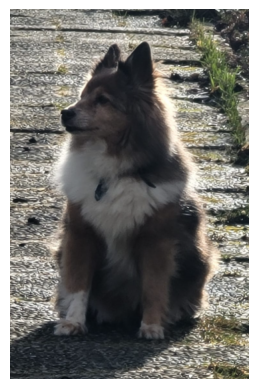

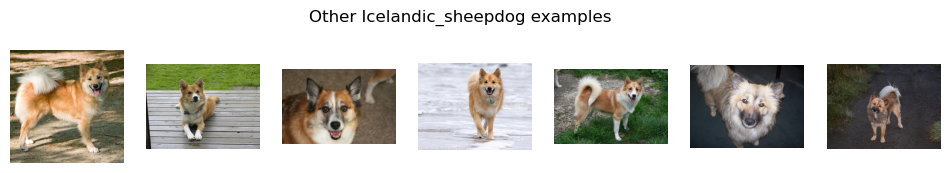

End


Analyzing image: random_test_images\dogs\001.jpeg
Doggo 🐕 found !
1/1 [==============================] - 1s 629ms/step
Looks like a Collie.
{'breed': 'Collie', 'human_pos': None, 'is_dog': True, 'is_human': False}


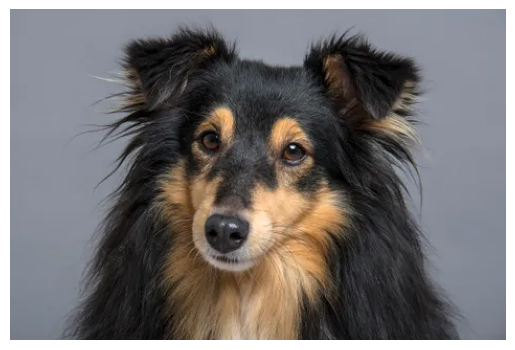

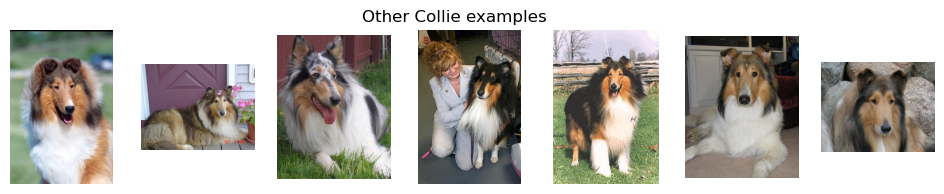

End


Analyzing image: random_test_images\dogs\1355996702_A-brown-and-white-Boxane-dog.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 630ms/step
Looks like a Boxer.
{'breed': 'Boxer', 'human_pos': None, 'is_dog': True, 'is_human': False}


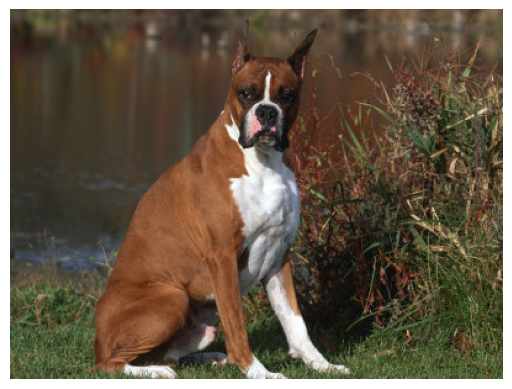

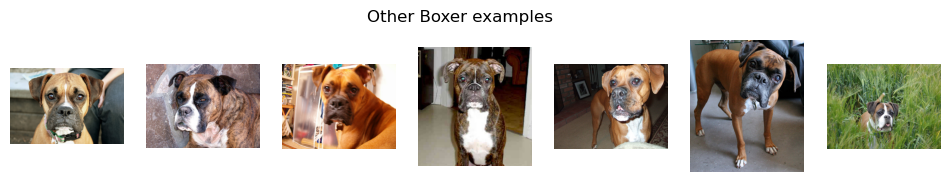

End


Analyzing image: random_test_images\dogs\234023992e6c4813861628774eabafd0.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 629ms/step
Looks like a Neapolitan_mastiff.
{'breed': 'Neapolitan_mastiff',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


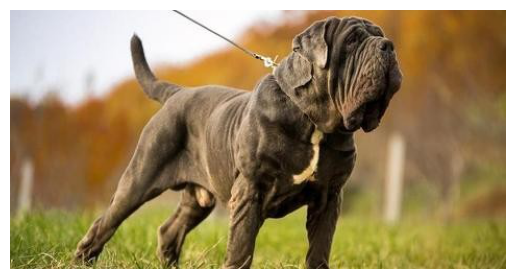

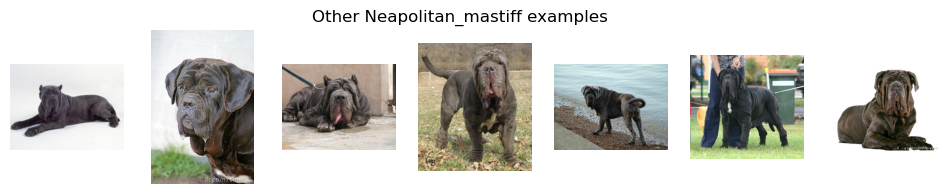

End


Analyzing image: random_test_images\dogs\246145-425x340-schnoodle-dog-cute.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 635ms/step
Looks like a Miniature_schnauzer.
{'breed': 'Miniature_schnauzer',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


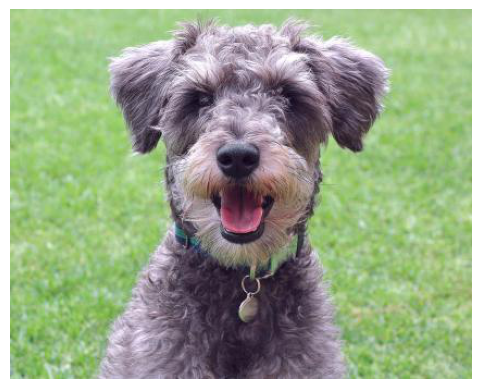

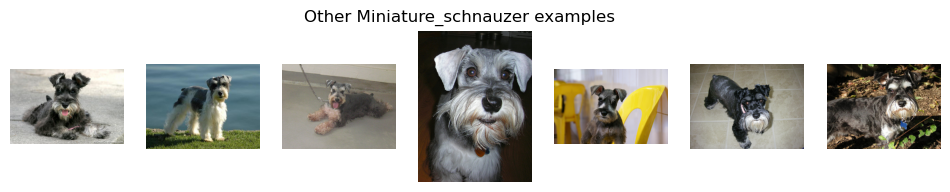

End


Analyzing image: random_test_images\dogs\5b9eb81a-6e08-4c11-9ded-885e073a975d.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 626ms/step
Looks like a Norwegian_buhund.
{'breed': 'Norwegian_buhund',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


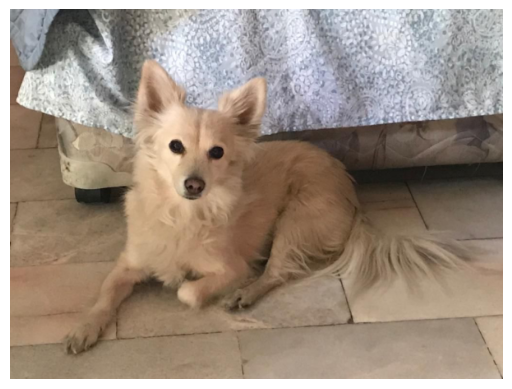

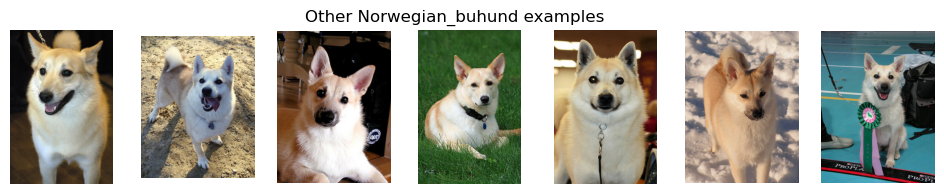

End


Analyzing image: random_test_images\dogs\5cd4358d7fc0a.webp
Doggo 🐕 found !
1/1 [==============================] - 1s 629ms/step
Looks like a Chihuahua.
{'breed': 'Chihuahua', 'human_pos': None, 'is_dog': True, 'is_human': False}


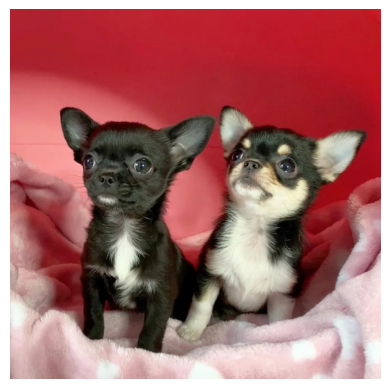

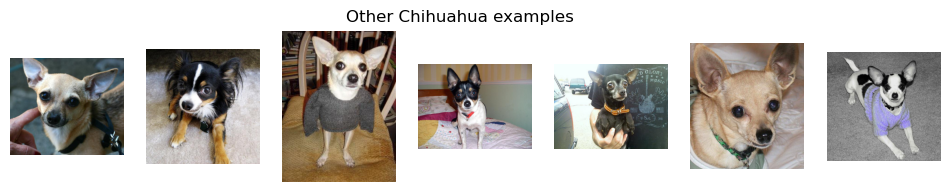

End


Analyzing image: random_test_images\dogs\9927eb4c-c9ab-4735-9308-95a108a21d44.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 908ms/step
Looks like a Canaan_dog.
{'breed': 'Canaan_dog', 'human_pos': None, 'is_dog': True, 'is_human': False}


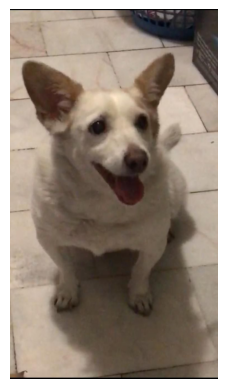

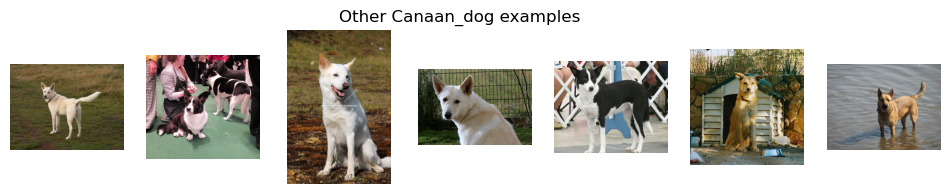

End


Analyzing image: random_test_images\dogs\american_staff.webp
Doggo 🐕 found !
1/1 [==============================] - 1s 631ms/step
Looks like a American_staffordshire_terrier.
{'breed': 'American_staffordshire_terrier',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


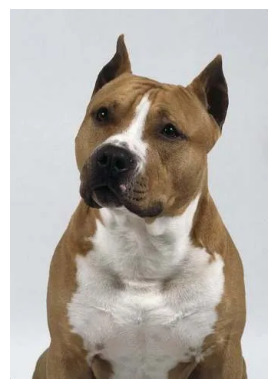

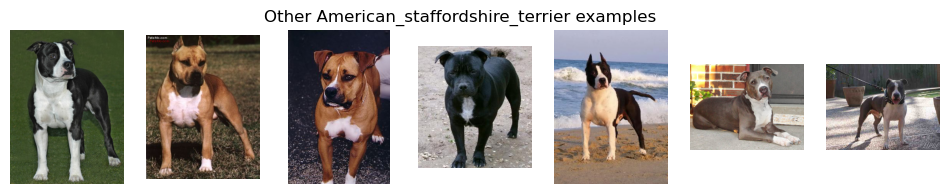

End


Analyzing image: random_test_images\dogs\black-labrodor-retriever.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 627ms/step
Looks like a Labrador_retriever.
{'breed': 'Labrador_retriever',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


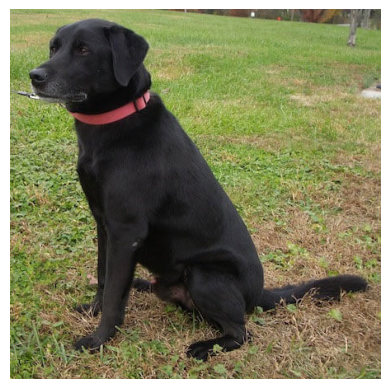

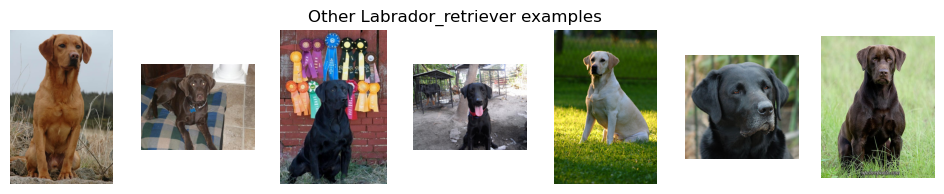

End


Analyzing image: random_test_images\dogs\Canaan-Dog-294x300.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 626ms/step
Looks like a Basenji.
{'breed': 'Basenji', 'human_pos': None, 'is_dog': True, 'is_human': False}


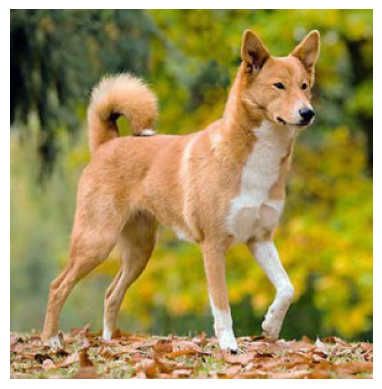

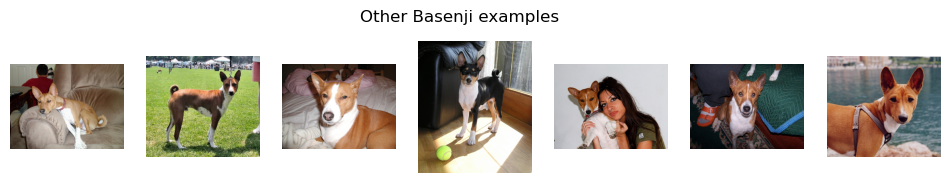

End


Analyzing image: random_test_images\dogs\DachshundPurebredDogWillowStandard3YearsOld4.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 625ms/step
Looks like a Dachshund.
{'breed': 'Dachshund', 'human_pos': None, 'is_dog': True, 'is_human': False}


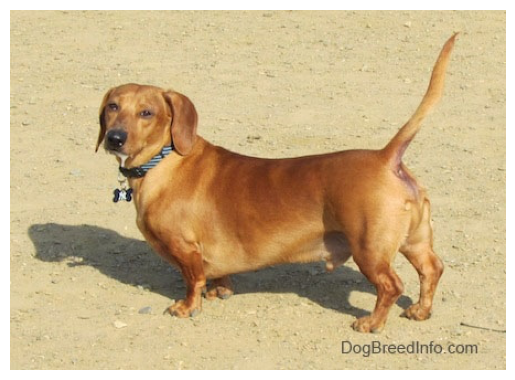

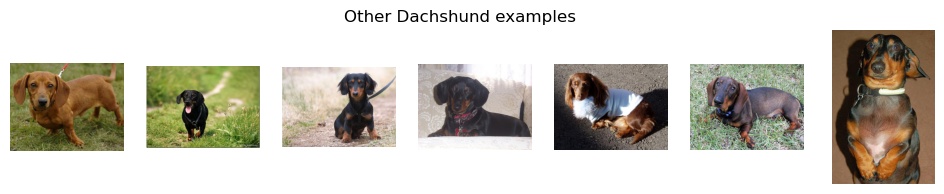

End


Analyzing image: random_test_images\dogs\Dallas_edit2-1024x745.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 898ms/step
Looks like a Dachshund.
{'breed': 'Dachshund', 'human_pos': None, 'is_dog': True, 'is_human': False}


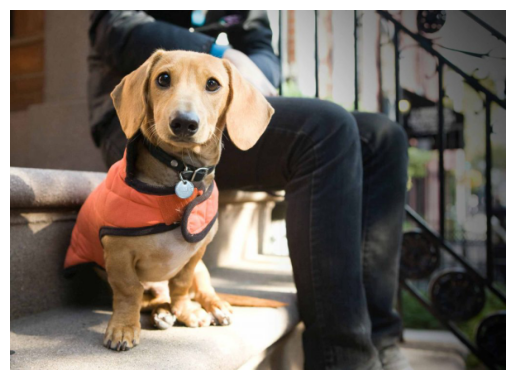

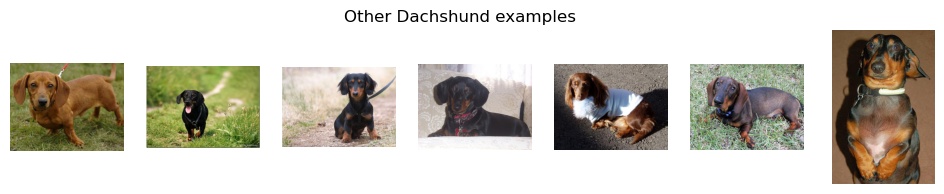

End


Analyzing image: random_test_images\dogs\Dog-Sitting.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 633ms/step
Looks like a Great_pyrenees.
{'breed': 'Great_pyrenees',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


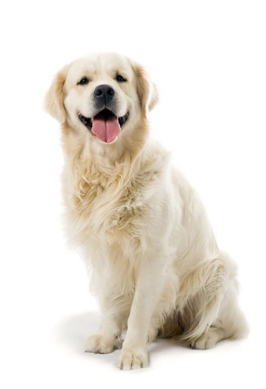

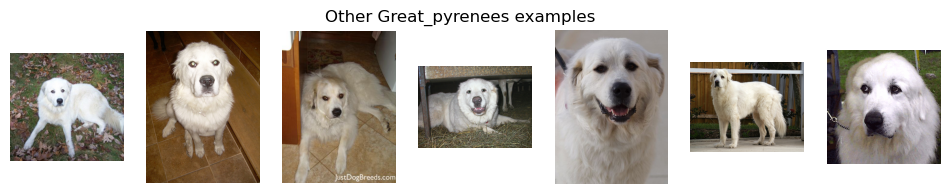

End


Analyzing image: random_test_images\dogs\fdaeea93-a12c-446f-95d7-d7251c491fc9.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 610ms/step
Looks like a Bouvier_des_flandres.
{'breed': 'Bouvier_des_flandres',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


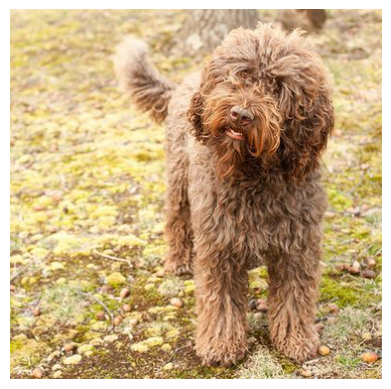

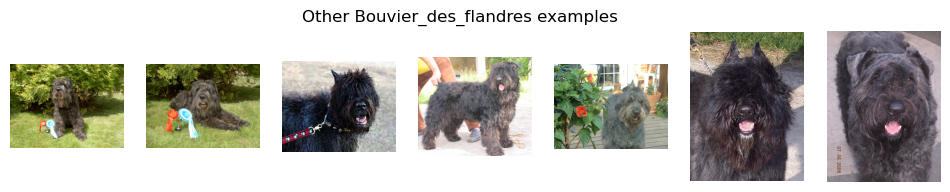

End


Analyzing image: random_test_images\dogs\Feature-Curly-Haired-Dog-Breeds-scaled.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 635ms/step
Looks like a Lakeland_terrier.
{'breed': 'Lakeland_terrier',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


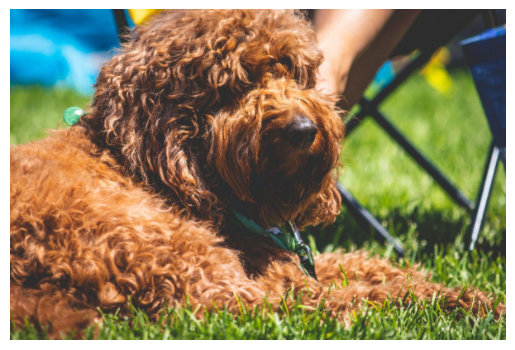

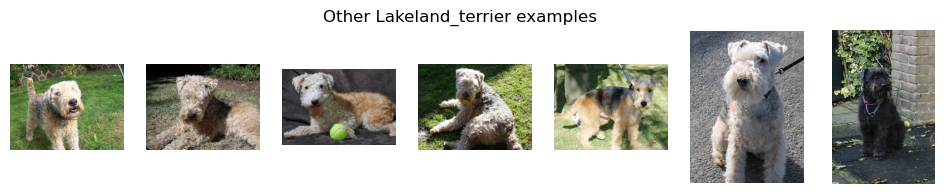

End


Analyzing image: random_test_images\dogs\LaizhouHongRedDogBambooTailKennelDog2.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 631ms/step
Looks like a Doberman_pinscher.
{'breed': 'Doberman_pinscher',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


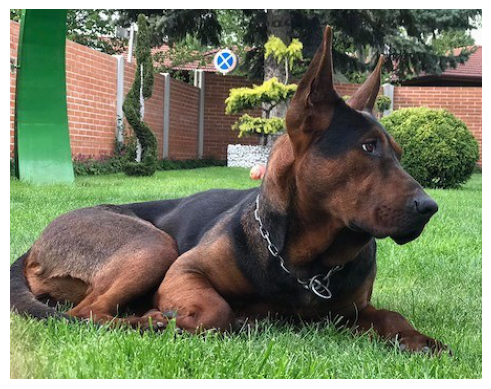

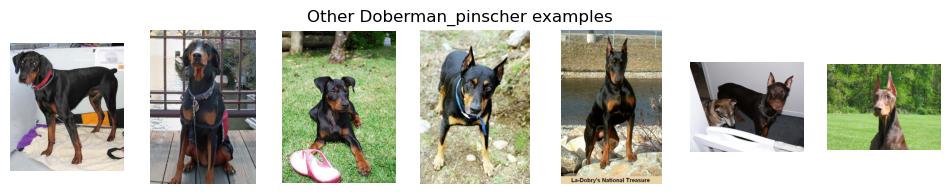

End


Analyzing image: random_test_images\dogs\Norwegian-Puffin-Dog.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 632ms/step
Looks like a Norwegian_lundehund.
{'breed': 'Norwegian_lundehund',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


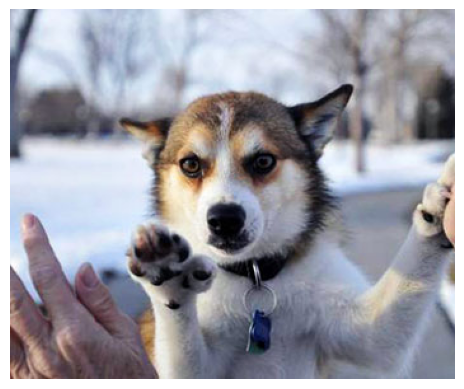

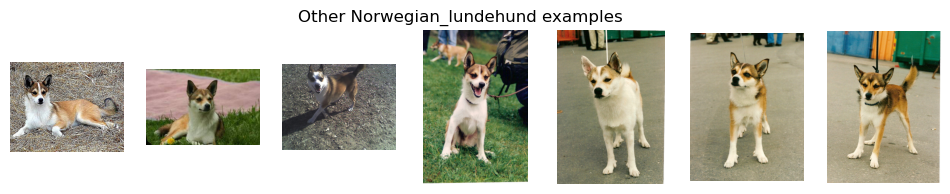

End


Analyzing image: random_test_images\dogs\pug-fattest-dogs-1600394338.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 631ms/step
Looks like a Bulldog.
{'breed': 'Bulldog', 'human_pos': None, 'is_dog': True, 'is_human': False}


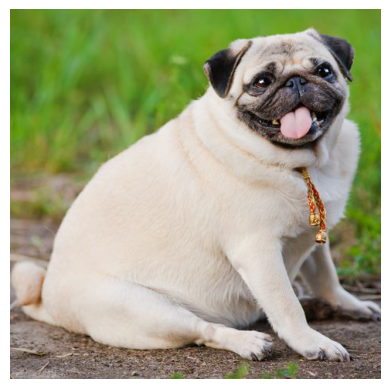

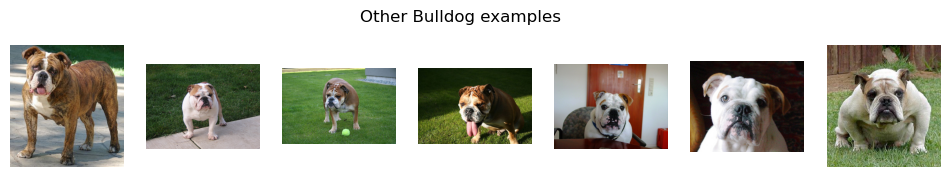

End


Analyzing image: random_test_images\dogs\ReagleRottweilerBeagleMixedBreedDogAtariPuppy4Months1.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 902ms/step
Looks like a Entlebucher_mountain_dog.
{'breed': 'Entlebucher_mountain_dog',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


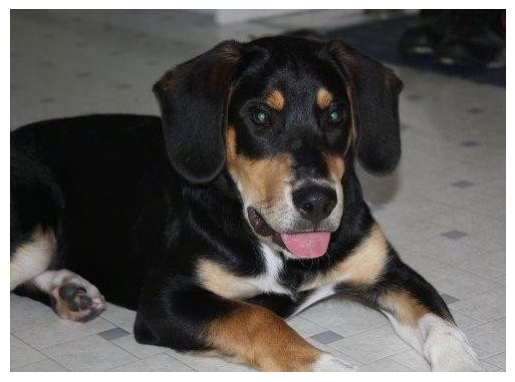

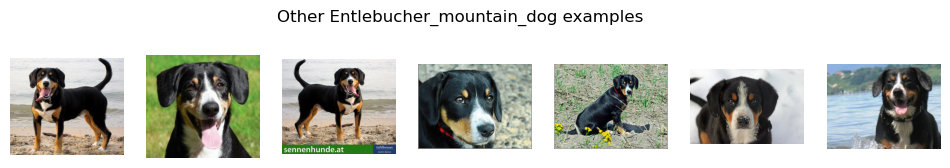

End


Analyzing image: random_test_images\dogs\trpd_k9_boris-731x1024.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 630ms/step
Looks like a Norwegian_elkhound.
{'breed': 'Norwegian_elkhound',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


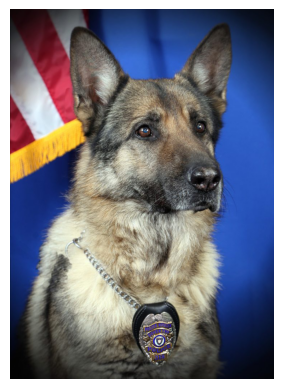

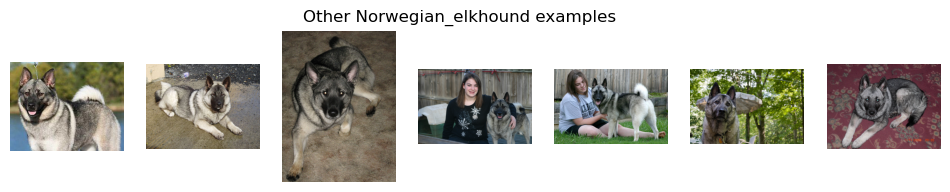

End


Analyzing image: random_test_images\dogs\whippet-dog_fvy2bw.webp
Doggo 🐕 found !
1/1 [==============================] - 1s 615ms/step
Looks like a Italian_greyhound.
{'breed': 'Italian_greyhound',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


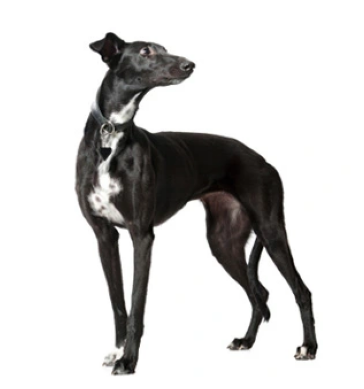

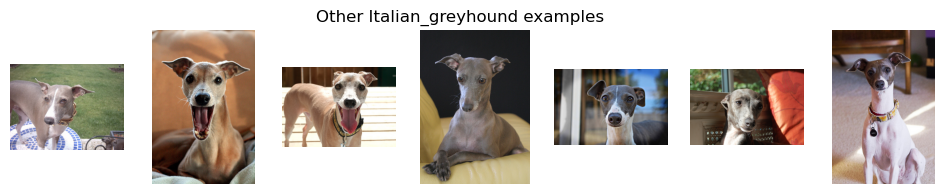

End


Analyzing image: random_test_images\dogs\yorkshire-terrier-running-on-lawn-520254142-5ab57cf1c06471003620f804.jpg
Doggo 🐕 found !
1/1 [==============================] - 1s 633ms/step
Looks like a Norwich_terrier.
{'breed': 'Norwich_terrier',
 'human_pos': None,
 'is_dog': True,
 'is_human': False}


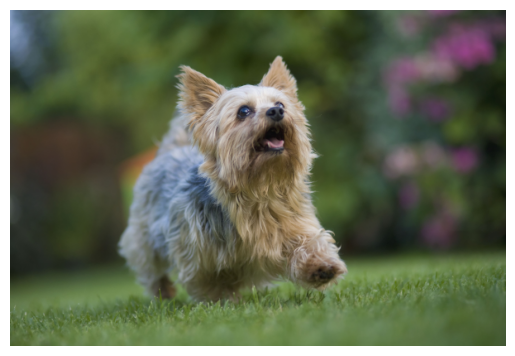

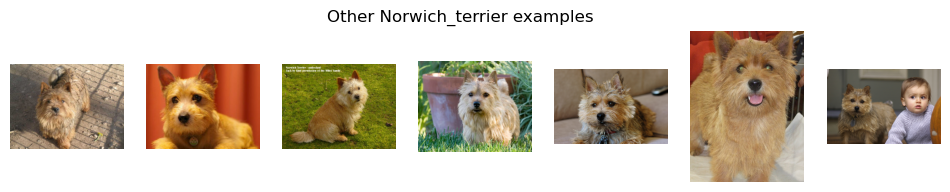

End


Analyzing image: random_test_images\humans\02-snoop-dogg-2017-cant-stop-wont-stop-premier-red-carpet-billboard-1548-compressed.jpg
Human 👩👨detected !
1/1 [==============================] - 1s 632ms/step
Anyway, he/she looks like a Smooth_fox_terrier.
{'breed': 'Smooth_fox_terrier',
 'human_pos': ((180, 57, 186, 185), 1.0),
 'is_dog': False,
 'is_human': True}


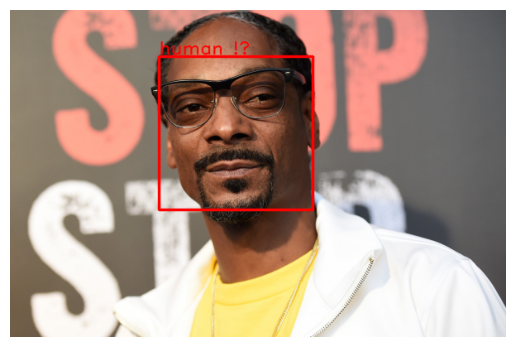

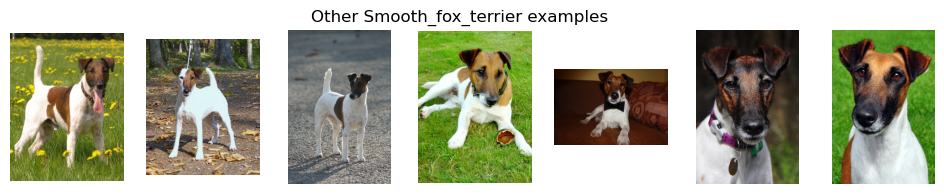

End


Analyzing image: random_test_images\humans\human-face-4.webp
Human 👩👨detected !
1/1 [==============================] - 1s 909ms/step
Anyway, he/she looks like a Bichon_frise.
{'breed': 'Bichon_frise',
 'human_pos': ((236, 133, 154, 155), 1.0),
 'is_dog': False,
 'is_human': True}


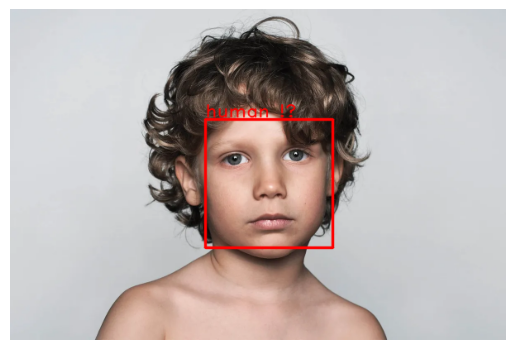

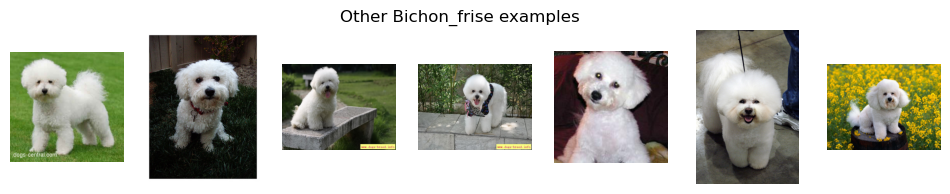

End


Analyzing image: random_test_images\humans\th-2513149514.jpg
Human 👩👨detected !
1/1 [==============================] - 1s 625ms/step
Anyway, he/she looks like a Anatolian_shepherd_dog.
{'breed': 'Anatolian_shepherd_dog',
 'human_pos': ((103, 68, 108, 107), 1.0),
 'is_dog': False,
 'is_human': True}


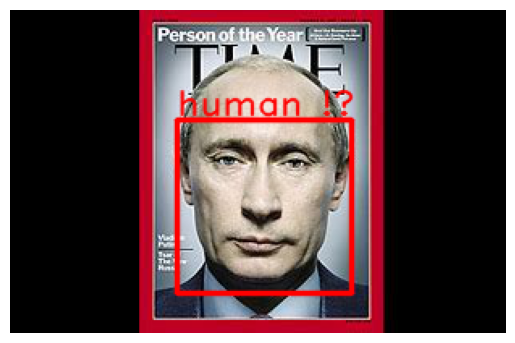

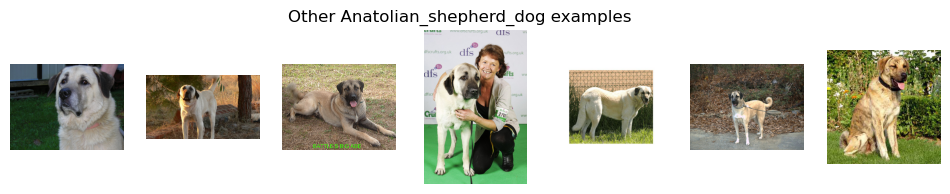

End


Analyzing image: random_test_images\humans\th.webp
Human 👩👨detected !
1/1 [==============================] - 1s 629ms/step
Anyway, he/she looks like a Dachshund.
{'breed': 'Dachshund',
 'human_pos': ((44, 80, 107, 107), 1.0),
 'is_dog': False,
 'is_human': True}


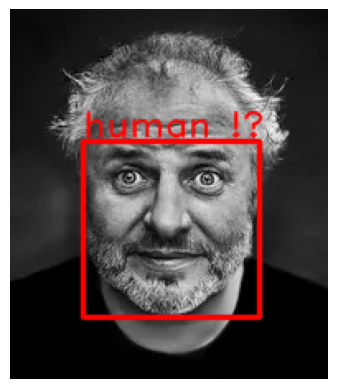

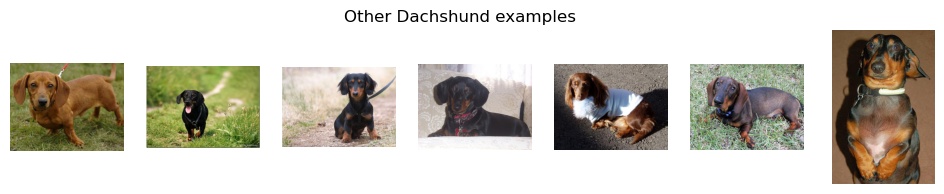

End




In [45]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

from glob import glob
from pprint import pprint
import matplotlib.image as mpimg

test_images = glob("random_test_images/*/*")

for i in test_images:

    res = predict_final(i)

    pprint(res[0])

    # display the image
    plt.imshow(res[1])
    plt.axis("off")
    plt.show()
    
    # print some images from the training set
    if res[0]["breed"] != None :
        qty = 7
        example_dir = [dir for dir in glob("dogImages/train/*/") if res[0]["breed"] == dir[20:-1]][0]
        fig, ax = plt.subplots(1, qty, figsize=(12, 2))
        fig.suptitle("Other {} examples".format(res[0]['breed']))
        for i, ex in enumerate(glob(example_dir+"/*")[:qty]):
            ax[i].imshow(mpimg.imread(ex))
            ax[i].axis("off")
        plt.show()
    
    print("End\n\n")